# User Analytics in the Telecommunication Industry

## Importing the Libraries

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

## Data Exploration

In [3]:
df = pd.read_csv('telcom_data.csv')

In [4]:
df.head()

,Bearer Id,Start,Start ms,End,End ms,Dur. (ms),IMSI,MSISDN/Number,IMEI,Last Location Name,...,Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes)
0,1.311450e+19,04-04-2019 12:01,770.0,25-04-2019 14:35,662.0,1823652.0,2.082010e+14,3.366496e+10,3.552120e+13,9.16457E+15,...,15854611.0,2501332.0,8198936.0,9656251.0,278082303.0,14344150.0,171744450.0,8814393.0,36749741.0,308879636.0
1,1.311450e+19,09-04-2019 13:04,235.0,25-04-2019 08:15,606.0,1365104.0,2.082020e+14,3.368185e+10,3.579400e+13,L77566A,...,20247395.0,19111729.0,18338413.0,17227132.0,608750074.0,1170709.0,526904238.0,15055145.0,53800391.0,653384965.0
2,1.311450e+19,09-04-2019 17:42,1.0,25-04-2019 11:58,652.0,1361762.0,2.082000e+14,3.376063e+10,3.528150e+13,D42335A,...,19725661.0,14699576.0,17587794.0,6163408.0,229584621.0,395630.0,410692588.0,4215763.0,27883638.0,279807335.0
3,1.311450e+19,10-04-2019 00:31,486.0,25-04-2019 07:36,171.0,1321509.0,2.082010e+14,3.375034e+10,3.535660e+13,T21824A,...,21388122.0,15146643.0,13994646.0,1097942.0,799538153.0,10849722.0,749039933.0,12797283.0,43324218.0,846028530.0
4,1.311450e+19,12-04-2019 20:10,565.0,25-04-2019 10:40,954.0,1089009.0,2.082010e+14,3.369980e+10,3.540700e+13,D88865A,...,15259380.0,18962873.0,17124581.0,415218.0,527707248.0,3529801.0,550709500.0,13910322.0,38542814.0,569138589.0


In [5]:
# Convert spaces into underscore in column name of dataframe and Uppercase to lowercase

def new_columns(df):
    df.columns= [column.replace(' ', '_').lower() for column in df.columns]
    return df

In [6]:
df = new_columns(df)

In [7]:
df

,bearer_id,start,start_ms,end,end_ms,dur._(ms),imsi,msisdn/number,imei,last_location_name,...,youtube_dl_(bytes),youtube_ul_(bytes),netflix_dl_(bytes),netflix_ul_(bytes),gaming_dl_(bytes),gaming_ul_(bytes),other_dl_(bytes),other_ul_(bytes),total_ul_(bytes),total_dl_(bytes)
0,1.311450e+19,04-04-2019 12:01,770.0,25-04-2019 14:35,662.0,1823652.0,2.082010e+14,3.366496e+10,3.552120e+13,9.16457E+15,...,15854611.0,2501332.00,8198936.00,9656251.00,278082303.0,1.434415e+07,171744450.0,8.814393e+06,36749741.0,308879636.0
1,1.311450e+19,09-04-2019 13:04,235.0,25-04-2019 08:15,606.0,1365104.0,2.082020e+14,3.368185e+10,3.579400e+13,L77566A,...,20247395.0,19111729.00,18338413.00,17227132.00,608750074.0,1.170709e+06,526904238.0,1.505514e+07,53800391.0,653384965.0
2,1.311450e+19,09-04-2019 17:42,1.0,25-04-2019 11:58,652.0,1361762.0,2.082000e+14,3.376063e+10,3.528150e+13,D42335A,...,19725661.0,14699576.00,17587794.00,6163408.00,229584621.0,3.956300e+05,410692588.0,4.215763e+06,27883638.0,279807335.0
3,1.311450e+19,10-04-2019 00:31,486.0,25-04-2019 07:36,171.0,1321509.0,2.082010e+14,3.375034e+10,3.535660e+13,T21824A,...,21388122.0,15146643.00,13994646.00,1097942.00,799538153.0,1.084972e+07,749039933.0,1.279728e+07,43324218.0,846028530.0
4,1.311450e+19,12-04-2019 20:10,565.0,25-04-2019 10:40,954.0,1089009.0,2.082010e+14,3.369980e+10,3.540700e+13,D88865A,...,15259380.0,18962873.00,17124581.00,415218.00,527707248.0,3.529801e+06,550709500.0,1.391032e+07,38542814.0,569138589.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149996,7.277830e+18,29-04-2019 07:28,451.0,30-04-2019 06:02,214.0,81230.0,2.082020e+14,3.365069e+10,3.548310e+13,D20434A,...,16191667.0,11763428.00,17883703.00,19678161.00,526609673.0,9.197207e+06,3264510.0,1.348742e+07,57628851.0,574175259.0
149997,7.349880e+18,29-04-2019 07:28,483.0,30-04-2019 10:41,187.0,97970.0,2.082020e+14,3.366345e+10,3.566050e+13,D10223C,...,13877234.0,8288284.00,19350146.00,21293148.00,626893062.0,4.735033e+06,712180387.0,2.457758e+06,39135081.0,666648844.0
149998,1.311450e+19,29-04-2019 07:28,283.0,30-04-2019 10:46,810.0,98249.0,2.082020e+14,3.362189e+10,3.572120e+13,T51102A,...,22660510.0,1855903.00,9963942.00,5065760.00,553539484.0,1.339432e+07,121100856.0,1.131473e+07,34912224.0,592786405.0
149999,1.311450e+19,29-04-2019 07:28,696.0,30-04-2019 10:40,327.0,97910.0,2.082020e+14,3.361962e+10,8.618620e+13,L88342B,...,8817106.0,8305402.00,3322253.00,13172589.00,352536971.0,2.529475e+06,814713113.0,1.406930e+06,29626096.0,371895920.0


## Data Description



* bearer id	:- xDr session identifier

* Dur. (ms)	:- Total Duration of the xDR (in ms)

* Start	:- Start time of the xDR (first frame timestamp)

* Start ms	:- Milliseconds offset of start time for the xDR (first frame timestamp)

* End	:- End time of the xDR (last frame timestamp)

* End ms	:- Milliseconds offset of end time of the xDR (last frame timestamp)

* Dur. (s)	:- Total Duration of the xDR (in s)

* IMSI	:- International Mobile Subscriber Identity

* MSISDN/Number	:- MS International PSTN/ISDN Number of mobile - customer number

* IMEI	:- International Mobile Equipment Identity

* Last Location Name	:- User location call name (2G/3G/4G) at the end of the bearer

* Avg RTT DL (ms)	:- Average Round Trip Time measurement Downlink direction (msecond)

* Avg RTT UL (ms)	:- Average Round Trip Time measurement Uplink direction (msecond)

* Avg Bearer TP DL (kbps)	:- Average Bearer Throughput for Downlink (kbps) - based on BDR duration

* Avg Bearer TP UL (kbps)	:- Average Bearer Throughput for uplink (kbps) - based on BDR duration

* TCP DL Retrans. Vol (Bytes)	:- TCP volume of Downlink packets detected as retransmitted (bytes)

* TCP UL Retrans. Vol (Bytes)	:- TCP volume of Uplink packets detected as retransmitted (bytes)

* DL TP < 50 Kbps (%)	:- Duration ratio when Bearer Downlink Throughput < ….

* 50 Kbps < DL TP < 250 Kbps (%)	:- Duration ratio when Bearer Downlink Throughput range is …

* 250 Kbps < DL TP < 1 Mbps (%)	:- Duration ratio when Bearer Downlink Throughput range is …

* DL TP > 1 Mbps (%)	:- Duration ratio when Bearer Downlink Throughput > ….

* UL TP < 10 Kbps (%)	:- Duration ratio when Bearer Uplink Throughput < ….

* 10 Kbps < UL TP < 50 Kbps (%)	:- Duration ratio when Bearer Uplink Throughput range is …

* 50 Kbps < UL TP < 300 Kbps (%)	:- Duration ratio when Bearer Uplink Throughput range is …

* UL TP > 300 Kbps (%)	:- Duration ratio when Bearer Uplink Throughput > ….

* HTTP DL (Bytes)	:- HTTP data volume (in Bytes) received by the MS during this session

* HTTP UL (Bytes)	:- HTTP data volume (in Bytes) sent by the MS during this session

* Activity Duration DL (ms)	:- Activity Duration for downlink (ms) - excluding periods of inactivity > 500 ms

* Activity Duration UL (ms)	:- Activity Duration for uplink (ms) - excluding periods of inactivity > 500 ms

* Dur. (ms).1	:- Total Duration of the xDR (in ms)

* Handset Manufacturer	:- Handset manufacturer

* Handset Type	:- Handset type of the mobile device

* Nb of sec with 125000B < Vol DL	:- Number of seconds with IP Volume DL >

* Nb of sec with 1250B < Vol UL < 6250B	:- Number of seconds with IP Volume UL between …

* Nb of sec with 31250B < Vol DL < 125000B	:- Number of seconds with IP Volume DL between …

* Nb of sec with 37500B < Vol UL	:- Number of seconds with IP Volume UL >

* Nb of sec with 6250B < Vol DL < 31250B	:- Number of seconds with IP Volume DL between …

* Nb of sec with 6250B < Vol UL < 37500B	:- Number of seconds with IP Volume UL between …

* Nb of sec with Vol DL < 6250B	:- Number of seconds with IP Volume DL <

* Nb of sec with Vol UL < 1250B	:- Number of seconds with IP Volume UL <

* Social Media DL (Bytes)	:- Social Media data volume (in Bytes) received by the MS during this session

* Social Media UL (Bytes)	:- Social Media data volume (in Bytes) sent by the MS during this session

* YouTube DL (Bytes)	:- YouTube data volume (in Bytes) received by the MS during this session

* YouTube UL (Bytes)	:- YouTube data volume (in Bytes) sent by the MS during this session

* Netflix DL (Bytes)	:- Netflix data volume (in Bytes) received by the MS during this session

* Netflix UL (Bytes)	:- Netflix data volume (in Bytes) sent by the MS during this session

* Google DL (Bytes)	:- Google data volume (in Bytes) Received by the MS during this session

* Google UL (Bytes)	:- Google data volume (in Bytes) sent by the MS during this session

* Email DL (Bytes)	:- Email data volume (in Bytes) Received by the MS during this session

* Email UL (Bytes)	:- Email data volume (in Bytes) sent by the MS during this session

* Gaming DL (Bytes)	:- Gaming data volume (in Bytes) Received by the MS during this session

* Gaming UL (Bytes)	:- Gaming data volume (in Bytes) sent by the MS during this session

* Other DL	:- Other data volume (in Bytes) received by the MS during this session

* Other UL	:- Other data volume (in Bytes) sent by the MS during this session

* Total DL (Bytes)	:- Data volume (in Bytes) received by the MS during this session (IP layer + overhead)

* Total UL (Bytes)	:- Data volume (in Bytes) sent by the MS during this session (IP layer + overhead)


In [8]:
# Data Info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150001 entries, 0 to 150000
Data columns (total 55 columns):
 #   Column                                    Non-Null Count   Dtype  
---  ------                                    --------------   -----  
 0   bearer_id                                 149010 non-null  float64
 1   start                                     150000 non-null  object 
 2   start_ms                                  150000 non-null  float64
 3   end                                       150000 non-null  object 
 4   end_ms                                    150000 non-null  float64
 5   dur._(ms)                                 150000 non-null  float64
 6   imsi                                      149431 non-null  float64
 7   msisdn/number                             148935 non-null  float64
 8   imei                                      149429 non-null  float64
 9   last_location_name                        148848 non-null  object 
 10  avg_rtt_dl_(ms)     

#### start, end, handset_manufacturer, handset_type and last_location has object type the rest are numeric types

In [9]:
### getting the null counts
df.isnull().sum()

bearer_id                                      991
start                                            1
start_ms                                         1
end                                              1
end_ms                                           1
dur._(ms)                                        1
imsi                                           570
msisdn/number                                 1066
imei                                           572
last_location_name                            1153
avg_rtt_dl_(ms)                              27829
avg_rtt_ul_(ms)                              27812
avg_bearer_tp_dl_(kbps)                          1
avg_bearer_tp_ul_(kbps)                          1
tcp_dl_retrans._vol_(bytes)                  88146
tcp_ul_retrans._vol_(bytes)                  96649
dl_tp_<_50_kbps_(%)                            754
50_kbps_<_dl_tp_<_250_kbps_(%)                 754
250_kbps_<_dl_tp_<_1_mbps_(%)                  754
dl_tp_>_1_mbps_(%)             

In [10]:
# Filling the missing Values

for i in df.columns:
    if df[i].dtypes == "object":
        mode_value = df[i].mode()[0]
        df[i].fillna(mode_value, inplace = True)
    elif df[i].dtypes != "object":
        mean_value = df[i].mean()
        df[i].fillna(mean_value, inplace = True)

In [11]:
df.isnull().sum()

bearer_id                                   0
start                                       0
start_ms                                    0
end                                         0
end_ms                                      0
dur._(ms)                                   0
imsi                                        0
msisdn/number                               0
imei                                        0
last_location_name                          0
avg_rtt_dl_(ms)                             0
avg_rtt_ul_(ms)                             0
avg_bearer_tp_dl_(kbps)                     0
avg_bearer_tp_ul_(kbps)                     0
tcp_dl_retrans._vol_(bytes)                 0
tcp_ul_retrans._vol_(bytes)                 0
dl_tp_<_50_kbps_(%)                         0
50_kbps_<_dl_tp_<_250_kbps_(%)              0
250_kbps_<_dl_tp_<_1_mbps_(%)               0
dl_tp_>_1_mbps_(%)                          0
ul_tp_<_10_kbps_(%)                         0
10_kbps_<_ul_tp_<_50_kbps_(%)     

### Top 10 handsets used by the customers

In [12]:
top_10_handsets = df["handset_type"].value_counts().head(10)
print("Top 10 Handsets used by Customers :")
print(top_10_handsets)

Top 10 Handsets used by Customers :
Huawei B528S-23A                20324
Apple iPhone 6S (A1688)          9419
Apple iPhone 6 (A1586)           9023
undefined                        8987
Apple iPhone 7 (A1778)           6326
Apple iPhone Se (A1723)          5187
Apple iPhone 8 (A1905)           4993
Apple iPhone Xr (A2105)          4568
Samsung Galaxy S8 (Sm-G950F)     4520
Apple iPhone X (A1901)           3813
Name: handset_type, dtype: int64


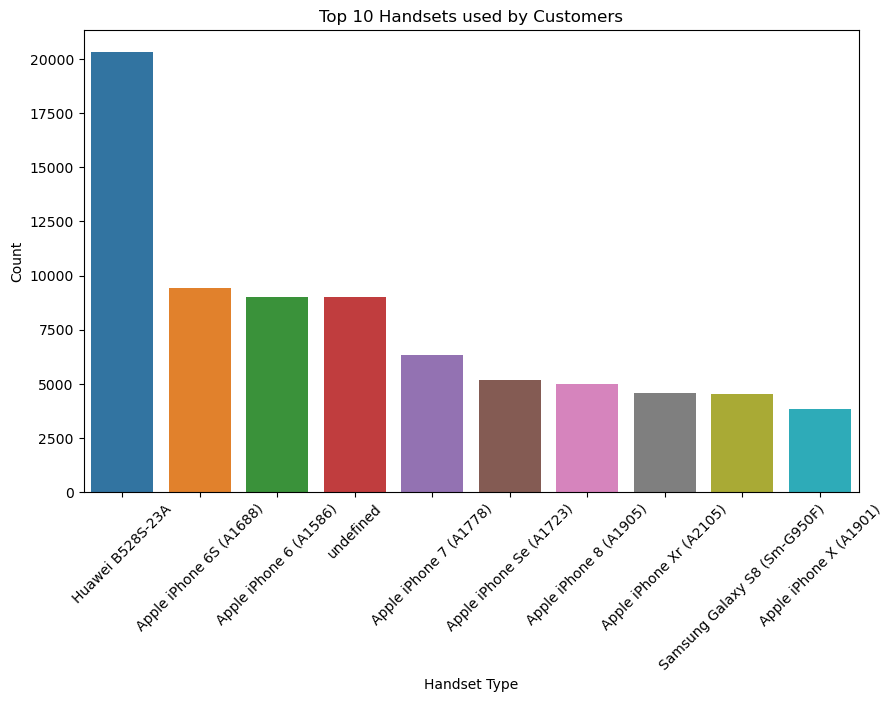

In [13]:
# Create a bar plot using seaborn
plt.figure(figsize=(10, 6))
sns.barplot(x=top_10_handsets.index, y=top_10_handsets.values)
plt.xlabel('Handset Type')
plt.ylabel('Count')
plt.title('Top 10 Handsets used by Customers')

# Rotate x-axis labels for better readability (optional)
plt.xticks(rotation=45)

# Show the plot
plt.show()

### Top 3 handset manufacturers

In [14]:
top_3_manufacturers = df["handset_manufacturer"].value_counts().head(3)
print("\nTop 3 Handsets Manufacturers :")
print(top_3_manufacturers)


Top 3 Handsets Manufacturers :
Apple      60137
Samsung    40839
Huawei     34423
Name: handset_manufacturer, dtype: int64


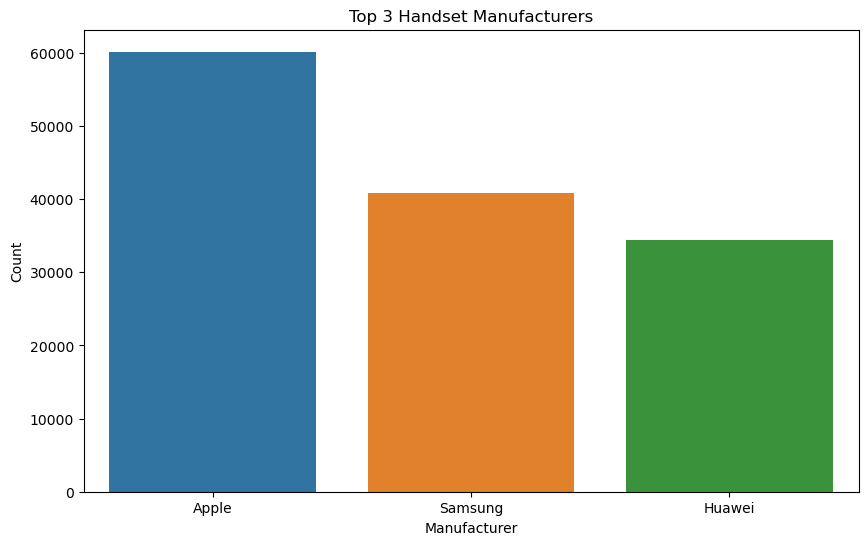

In [15]:
plt.figure(figsize=(10, 6))
sns.barplot(x=top_3_manufacturers.index, y=top_3_manufacturers.values)
plt.title("Top 3 Handset Manufacturers")
plt.xlabel("Manufacturer")
plt.ylabel("Count")
plt.show()

### The top 5 handsets per top 3 handset manufacturer



Manufacturer : Apple
Apple iPhone 6S (A1688)    9419
Apple iPhone 6 (A1586)     9023
Apple iPhone 7 (A1778)     6326
Apple iPhone Se (A1723)    5187
Apple iPhone 8 (A1905)     4993
Name: handset_type, dtype: int64


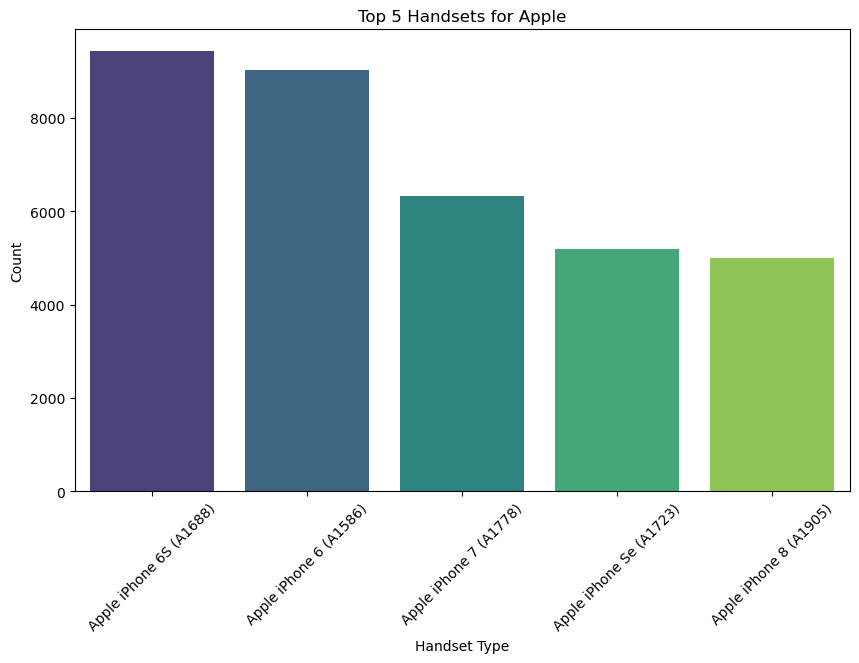


Manufacturer : Samsung
Samsung Galaxy S8 (Sm-G950F)    4520
Samsung Galaxy A5 Sm-A520F      3724
Samsung Galaxy J5 (Sm-J530)     3696
Samsung Galaxy J3 (Sm-J330)     3484
Samsung Galaxy S7 (Sm-G930X)    3199
Name: handset_type, dtype: int64


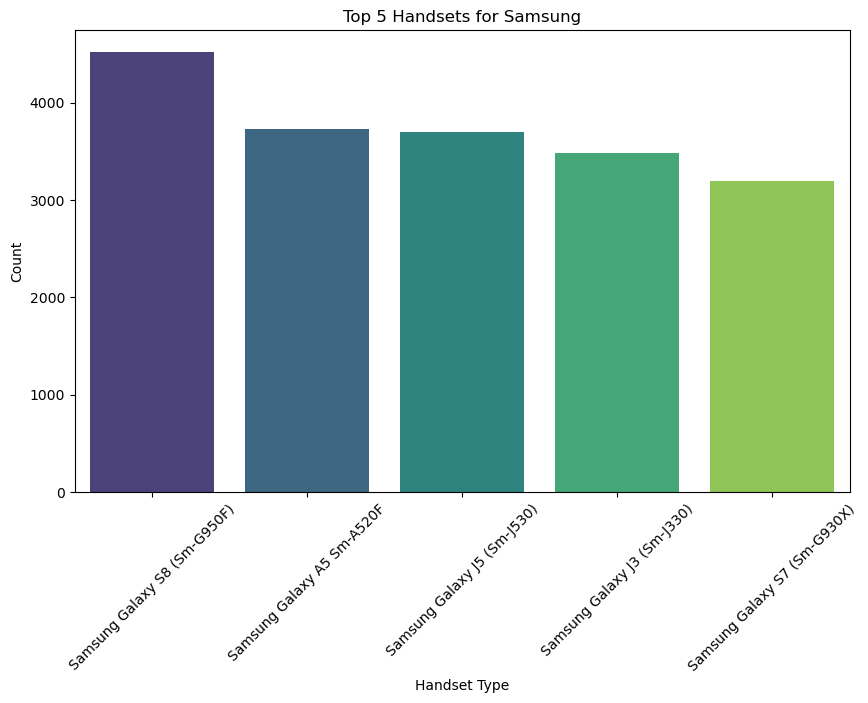


Manufacturer : Huawei
Huawei B528S-23A                  19752
Huawei E5180                       2079
Huawei P20 Lite Huawei Nova 3E     2021
Huawei P20                         1480
Huawei Y6 2018                      997
Name: handset_type, dtype: int64


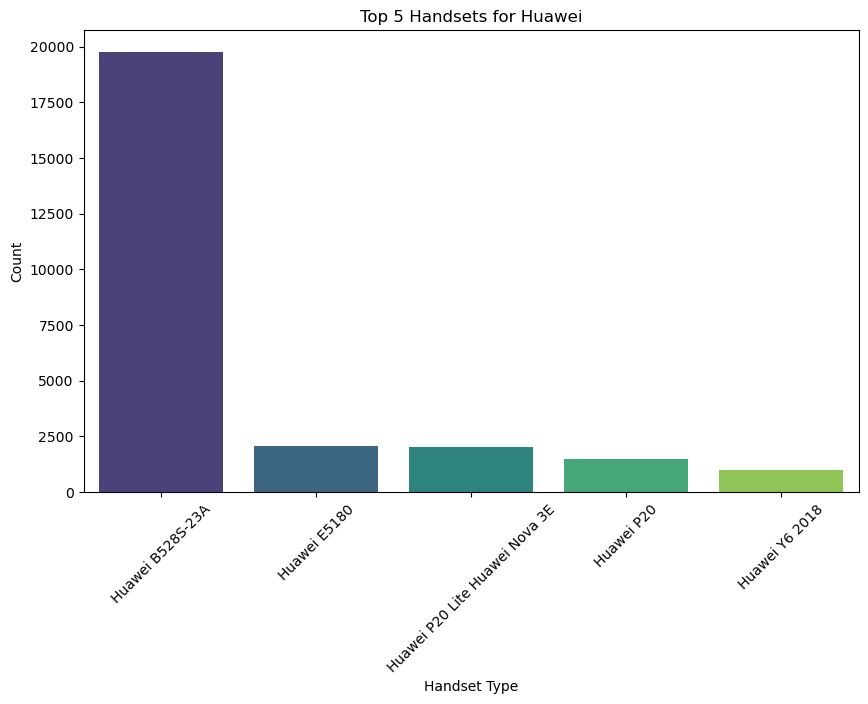

In [16]:
top_5_handsets_per_manufacturer = {}
for manufacturer in top_3_manufacturers.index:
    manufacturer_data = df[df["handset_manufacturer"] == manufacturer]
    top_5_handsets = manufacturer_data["handset_type"].value_counts().head(5)
    top_5_handsets_per_manufacturer[manufacturer]= top_5_handsets
    
# Plotting the top 5 handsets for each manufacturer
for manufacturer, top_5_handsets in top_5_handsets_per_manufacturer.items():
    print(f"\nManufacturer : {manufacturer}")
    print(top_5_handsets)
    plt.figure(figsize=(10, 6))
    sns.barplot(x=top_5_handsets.index, y=top_5_handsets.values, palette="viridis")
    plt.xlabel("Handset Type")
    plt.ylabel("Count")
    plt.title(f"Top 5 Handsets for {manufacturer}")
    plt.xticks(rotation=45)
    plt.show()  

### Interpretation
* Huawei B528S-23A is the most popular handset, indicating a significant customer preference for this particular model.

* Apple iPhones dominate the top positions, highlighting their strong presence in the market and popularity among customers.

* The presence of an "Undefined" entry suggests the need for further investigation to clarify the handset types and ensure accurate data representation.

### Recommendations
* Given the high usage of the Huawei B528S-23A handset, consider establishing partnerships or collaborations with Huawei to leverage its popularity. Explore co-marketing opportunities, exclusive offers, or joint campaigns to target customers who are using this specific model.

* Capitalize on Apple's Success: With multiple Apple iPhone models appearing in the top 10 list, focus on creating targeted marketing campaigns that emphasize the unique features, performance, and user experience offered by these handsets.

# Task 1.1

### Aggregate per user the following information in the column¶
* Number of xDR sessions
* Session duration
* The total download (DL) and upload (UL) data
* The total data volume (in Bytes) during this session for each application

In [17]:
df1 =df.rename(columns={'msisdn/number': 'msisdn', 'dur._(ms)': 'duration' })

In [18]:
df1

,bearer_id,start,start_ms,end,end_ms,duration,imsi,msisdn,imei,last_location_name,...,youtube_dl_(bytes),youtube_ul_(bytes),netflix_dl_(bytes),netflix_ul_(bytes),gaming_dl_(bytes),gaming_ul_(bytes),other_dl_(bytes),other_ul_(bytes),total_ul_(bytes),total_dl_(bytes)
0,1.311450e+19,04-04-2019 12:01,770.0000,25-04-2019 14:35,662.00000,1.823652e+06,2.082010e+14,3.366496e+10,3.552120e+13,9.16457E+15,...,15854611.0,2501332.00,8198936.00,9656251.00,278082303.0,1.434415e+07,171744450.0,8.814393e+06,3.674974e+07,3.088796e+08
1,1.311450e+19,09-04-2019 13:04,235.0000,25-04-2019 08:15,606.00000,1.365104e+06,2.082020e+14,3.368185e+10,3.579400e+13,L77566A,...,20247395.0,19111729.00,18338413.00,17227132.00,608750074.0,1.170709e+06,526904238.0,1.505514e+07,5.380039e+07,6.533850e+08
2,1.311450e+19,09-04-2019 17:42,1.0000,25-04-2019 11:58,652.00000,1.361762e+06,2.082000e+14,3.376063e+10,3.528150e+13,D42335A,...,19725661.0,14699576.00,17587794.00,6163408.00,229584621.0,3.956300e+05,410692588.0,4.215763e+06,2.788364e+07,2.798073e+08
3,1.311450e+19,10-04-2019 00:31,486.0000,25-04-2019 07:36,171.00000,1.321509e+06,2.082010e+14,3.375034e+10,3.535660e+13,T21824A,...,21388122.0,15146643.00,13994646.00,1097942.00,799538153.0,1.084972e+07,749039933.0,1.279728e+07,4.332422e+07,8.460285e+08
4,1.311450e+19,12-04-2019 20:10,565.0000,25-04-2019 10:40,954.00000,1.089009e+06,2.082010e+14,3.369980e+10,3.540700e+13,D88865A,...,15259380.0,18962873.00,17124581.00,415218.00,527707248.0,3.529801e+06,550709500.0,1.391032e+07,3.854281e+07,5.691386e+08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149996,7.277830e+18,29-04-2019 07:28,451.0000,30-04-2019 06:02,214.00000,8.123000e+04,2.082020e+14,3.365069e+10,3.548310e+13,D20434A,...,16191667.0,11763428.00,17883703.00,19678161.00,526609673.0,9.197207e+06,3264510.0,1.348742e+07,5.762885e+07,5.741753e+08
149997,7.349880e+18,29-04-2019 07:28,483.0000,30-04-2019 10:41,187.00000,9.797000e+04,2.082020e+14,3.366345e+10,3.566050e+13,D10223C,...,13877234.0,8288284.00,19350146.00,21293148.00,626893062.0,4.735033e+06,712180387.0,2.457758e+06,3.913508e+07,6.666488e+08
149998,1.311450e+19,29-04-2019 07:28,283.0000,30-04-2019 10:46,810.00000,9.824900e+04,2.082020e+14,3.362189e+10,3.572120e+13,T51102A,...,22660510.0,1855903.00,9963942.00,5065760.00,553539484.0,1.339432e+07,121100856.0,1.131473e+07,3.491222e+07,5.927864e+08
149999,1.311450e+19,29-04-2019 07:28,696.0000,30-04-2019 10:40,327.00000,9.791000e+04,2.082020e+14,3.361962e+10,8.618620e+13,L88342B,...,8817106.0,8305402.00,3322253.00,13172589.00,352536971.0,2.529475e+06,814713113.0,1.406930e+06,2.962610e+07,3.718959e+08


## Number of xDR sessions

In [19]:
# xDr Session
session_count = df1.groupby('msisdn').agg({'bearer_id': 'count'})
session_count = session_count.rename(columns= {'bearer_id': 'xDR_sessions'})
session_count.sort_values(by=['xDR_sessions'], ascending = False).head(10)

,xDR_sessions
msisdn,
4.188282e+10,1066
3.362632e+10,18
3.362578e+10,17
3.361489e+10,17
3.365973e+10,16
3.367588e+10,15
3.376054e+10,15
3.366716e+10,13
3.360452e+10,12


In [20]:
session_count.describe()

,xDR_sessions
count,106857.000000
mean,1.403755
std,3.355032
min,1.000000
25%,1.000000
50%,1.000000
75%,2.000000
max,1066.000000


### Session duration

In [21]:
session_duration = df1.groupby('msisdn').agg({'duration': 'count'})
session_duration = session_duration.rename(columns= {'duration': 'total_duration(ms)'})
session_duration.sort_values(by=['total_duration(ms)'], ascending = False).head(10)

,total_duration(ms)
msisdn,
4.188282e+10,1066
3.362632e+10,18
3.362578e+10,17
3.361489e+10,17
3.365973e+10,16
3.367588e+10,15
3.376054e+10,15
3.366716e+10,13
3.360452e+10,12


In [22]:
session_duration.describe()

,total_duration(ms)
count,106857.000000
mean,1.403755
std,3.355032
min,1.000000
25%,1.000000
50%,1.000000
75%,2.000000
max,1066.000000


## The total download (DL) and upload (UL) data

In [23]:
total_data_df = df1[['msisdn','total_ul_(bytes)','total_dl_(bytes)']].copy()
total_data_df = total_data_df.groupby('msisdn').sum()
total_data_df['total_data(bytes)'] = total_data_df['total_dl_(bytes)'] + total_data_df['total_ul_(bytes)']
total_data_df.sort_values(by=['total_data(bytes)'], ascending = False).head(10)

,total_ul_(bytes),total_dl_(bytes),total_data(bytes)
msisdn,,,
4.188282e+10,4.436642e+10,4.873783e+11,5.317447e+11
3.361489e+10,6.894830e+08,8.156743e+09,8.846226e+09
3.376054e+10,7.034786e+08,7.811295e+09,8.514774e+09
3.362578e+10,7.295774e+08,7.770043e+09,8.499621e+09
3.362632e+10,6.696507e+08,7.301517e+09,7.971167e+09
3.367588e+10,5.815688e+08,7.309542e+09,7.891111e+09
3.365973e+10,6.242603e+08,7.081602e+09,7.705863e+09
3.366646e+10,4.050610e+08,6.903440e+09,7.308501e+09
3.376041e+10,5.215189e+08,6.610852e+09,7.132371e+09


In [24]:
total_data_df.describe().style.background_gradient(cmap = "Oranges")

,total_ul_(bytes),total_dl_(bytes),total_data(bytes)
count,106857.000000,106857.000000,106857.000000
mean,57724080.453525,638207783.816456,695931864.269981
std,140159146.800785,1559801680.297335,1697157568.672740
min,2866892.000000,8827082.000000,33249009.000000
25%,36395537.000000,314830188.000000,358552970.000000
50%,46794345.000000,570371256.000000,617923242.000000
75%,65733763.000000,807370116.000000,857435777.000000
max,44366423488.292107,487378285756.078979,531744709244.371094


### The total data volume (in Bytes) during this session for each application

We need to combine the total UL and Dl data of each application

In [25]:
df1["social_media"] = df1["social_media_dl_(bytes)"] + df1['social_media_ul_(bytes)']
df1["google"] = df1["google_dl_(bytes)"] + df1["google_ul_(bytes)"]
df1['email'] = df1["email_dl_(bytes)"] + df1["email_ul_(bytes)"]
df1['youtube'] = df1["youtube_dl_(bytes)"] + df1["youtube_ul_(bytes)"]
df1['netflix'] = df1["netflix_dl_(bytes)"] + df1["netflix_ul_(bytes)"]
df1["gaming"] = df1["gaming_dl_(bytes)"] + df1["gaming_ul_(bytes)"]
df1['other']= df1["other_dl_(bytes)"]+ df1["other_ul_(bytes)"]
df1['total_data'] = df1['total_dl_(bytes)'] + df1['total_ul_(bytes)']

In [26]:
total_data_by_app = df1[['msisdn','social_media','google','email', 'youtube','netflix', 'gaming','other']].copy()

In [27]:
total_data_by_app.groupby('msisdn').sum().sample(10)

,social_media,google,email,youtube,netflix,gaming,other
msisdn,,,,,,,
3.366535e+10,70877.0,4048776.0,862755.0,38364829.0,16514630.0,1.019401e+08,7.527710e+08
3.366384e+10,5693392.0,16191993.0,5589315.0,37273016.0,35229364.0,8.623325e+08,1.423223e+09
3.369816e+10,1155741.0,9197672.0,737738.0,34280477.0,24130596.0,1.454169e+08,4.467030e+08
3.360762e+10,2220039.0,9485789.0,3334291.0,19875421.0,25948424.0,4.836095e+08,1.858234e+08
3.376342e+10,4325968.0,12123294.0,5536744.0,43335592.0,52004705.0,1.049509e+09,1.190287e+09
3.368926e+10,1838537.0,14223037.0,4284778.0,47749402.0,51691479.0,1.034289e+09,6.734040e+08
3.366346e+10,556633.0,15201064.0,2461208.0,40836707.0,38631198.0,1.508441e+09,1.045680e+09
3.363138e+10,2242426.0,7612404.0,3399792.0,44852893.0,49825042.0,1.205341e+09,9.659049e+08
3.366337e+10,1918948.0,13078515.0,2907754.0,26514235.0,17780426.0,5.858832e+07,4.114289e+08


In [28]:
total_data_by_app.describe().style.background_gradient(cmap = "Blues")

,msisdn,social_media,google,email,youtube,netflix,gaming,other
count,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000,150001.000000
mean,41882818562.270477,1828250.208027,7807294.545573,2259102.309960,22643482.638600,22628606.538380,430333100.706107,429365343.618920
std,2438730974705.822266,1035646.138004,3516420.237959,1071109.060618,9246800.306557,9260820.086194,244019924.020530,243268073.291605
min,33601001722.000000,1563.000000,40330.000000,8359.000000,78903.000000,98432.000000,306358.000000,149045.000000
25%,33651508781.000000,932218.000000,4943599.000000,1359344.000000,15998463.000000,15979455.000000,218727939.000000,218553417.000000
50%,33663797508.000000,1826471.000000,7812835.000000,2263567.000000,22661770.000000,22635545.000000,431614977.000000,429986492.000000
75%,33684730950.000000,2727487.000000,10682796.000000,3159818.000000,29292604.000000,29290445.000000,641415878.000000,639927495.000000
max,882397000000000.000000,3650861.000000,15528782.000000,4518036.000000,45190078.000000,45198153.000000,859202784.000000,859520934.000000


# Task 1.2

#### 1. Conduct exploratory data analysis on those data & communicate useful insights.
#### 2. Identify and treat all missing values and outliers in the dataset by replacing them with the mean of the corresponding column.
#### 3. Report about the following using Python script and slide :

• Describe all relevant variables and associated data types (slide).

• Analyze the basic metrics (mean, median, etc) in the Dataset (explain) & their importance for the global objective.

• Conduct a Non-Graphical Univariate Analysis by computing dispersion parameters for each quantitative variable and provide useful interpretation.

• Conduct a Graphical Univariate Analysis by identifying the most suitable plotting options for each variable and interpreting your findings.

• Bivariate Analysis – explore the relationship between each application & the total DL+UL data using appropriate methods and interpret your findings.

• Variable transformations – segment the users into the top five decile classes based on the total duration for all sessions and compute the total data (DL+UL) per decile class.

• Correlation Analysis – compute a correlation matrix for the following variables and interpret your findings: Social Media data, Google data, Email data, Youtube data, Netflix data, Gaming data, and Other data

• Dimensionality Reduction – perform a principal component analysis to reduce the dimensions of your data and provide a useful interpretation of the results (Provide your interpretation in four (4) bullet points maximum).

## Univarent graphical analysis

In [29]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150001 entries, 0 to 150000
Data columns (total 63 columns):
 #   Column                                    Non-Null Count   Dtype  
---  ------                                    --------------   -----  
 0   bearer_id                                 150001 non-null  float64
 1   start                                     150001 non-null  object 
 2   start_ms                                  150001 non-null  float64
 3   end                                       150001 non-null  object 
 4   end_ms                                    150001 non-null  float64
 5   duration                                  150001 non-null  float64
 6   imsi                                      150001 non-null  float64
 7   msisdn                                    150001 non-null  float64
 8   imei                                      150001 non-null  float64
 9   last_location_name                        150001 non-null  object 
 10  avg_rtt_dl_(ms)     

There are 5 categoriacl features; rest are Numerical features present in this dataset

In [29]:
for i in df1.columns:
    print("*"*50)
    print("The datatype for {} is {}".format(i,df1[i].dtypes))
    # check if the datatype is object or not
    if df1[i].dtypes ==  "object":
        print("Top 10 categories for ", i )
        print(df1[i].value_counts().sort_values(ascending = False).head(10))
        print("*"*50)

**************************************************
The datatype for bearer_id is float64
**************************************************
The datatype for start is object
Top 10 categories for  start
26-04-2019 07:25    204
26-04-2019 07:26    190
26-04-2019 07:36    175
26-04-2019 07:30    160
26-04-2019 07:46    143
26-04-2019 07:49    138
26-04-2019 07:40    135
26-04-2019 08:25    135
26-04-2019 07:45    133
26-04-2019 07:31    132
Name: start, dtype: int64
**************************************************
**************************************************
The datatype for start_ms is float64
**************************************************
The datatype for end is object
Top 10 categories for  end
25-04-2019 00:01    1151
25-04-2019 00:02     418
25-04-2019 00:00     296
25-04-2019 00:48     286
28-04-2019 00:00     275
25-04-2019 00:03     250
28-04-2019 00:06     248
28-04-2019 00:04     246
28-04-2019 00:02     238
28-04-2019 00:05     236
Name: end, dtype: int64
**********

In [30]:
# Univariate Analysis for Categorical data
categorical_data = []
for col in df1.columns:
    if df1[col].dtypes == "object":
        categorical_data.append(col)

**************************************************
Top 10 categories for start
26-04-2019 07:25    204
26-04-2019 07:26    190
26-04-2019 07:36    175
26-04-2019 07:30    160
26-04-2019 07:46    143
26-04-2019 07:49    138
26-04-2019 07:40    135
26-04-2019 08:25    135
26-04-2019 07:45    133
26-04-2019 07:31    132
Name: start, dtype: int64


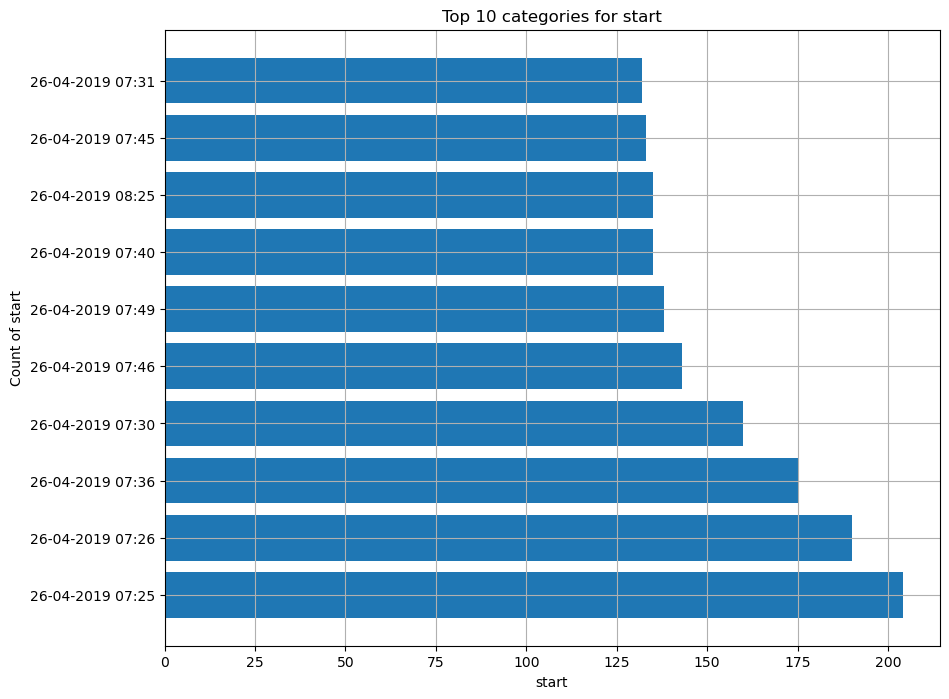

**************************************************
**************************************************
Top 10 categories for end
25-04-2019 00:01    1151
25-04-2019 00:02     418
25-04-2019 00:00     296
25-04-2019 00:48     286
28-04-2019 00:00     275
25-04-2019 00:03     250
28-04-2019 00:06     248
28-04-2019 00:04     246
28-04-2019 00:02     238
28-04-2019 00:05     236
Name: end, dtype: int64


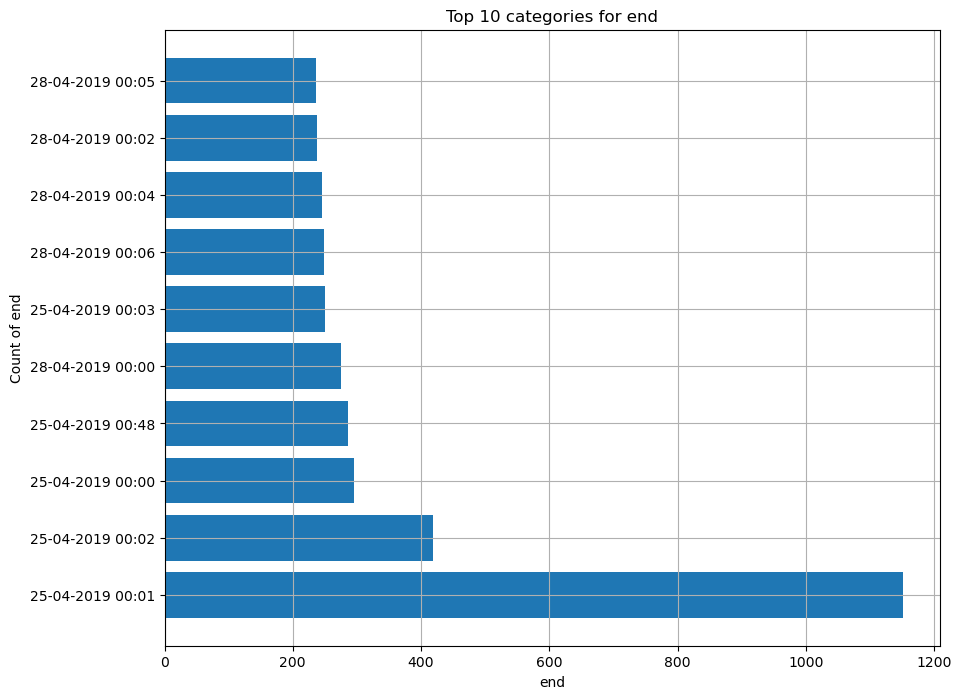

**************************************************
**************************************************
Top 10 categories for last_location_name
9.16457E+15    3034
8.12222E+16     187
D41377B          80
1.5328E+17       61
D17085A          59
D72396C          57
D73604C          55
D11119B          54
L41377B          51
D11002B          50
Name: last_location_name, dtype: int64


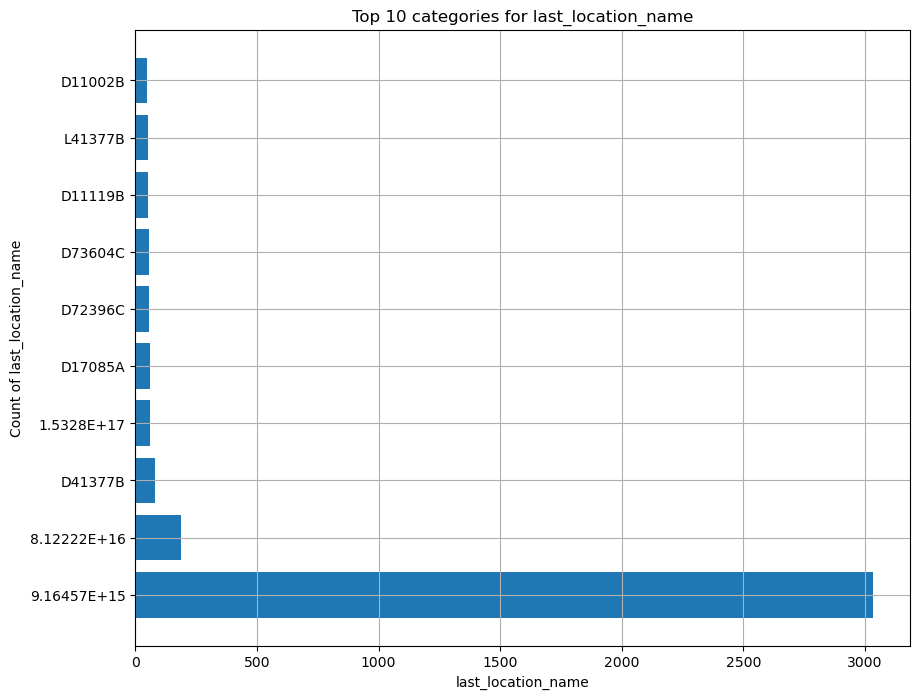

**************************************************
**************************************************
Top 10 categories for handset_manufacturer
Apple                                   60137
Samsung                                 40839
Huawei                                  34423
undefined                                8987
Sony Mobile Communications Ab             980
Wiko Global Sasu                          747
Xiaomi Communications Co Ltd              397
Oneplus Technology (Shenzhen) Co Ltd      342
Asustek                                   285
Lenovo                                    254
Name: handset_manufacturer, dtype: int64


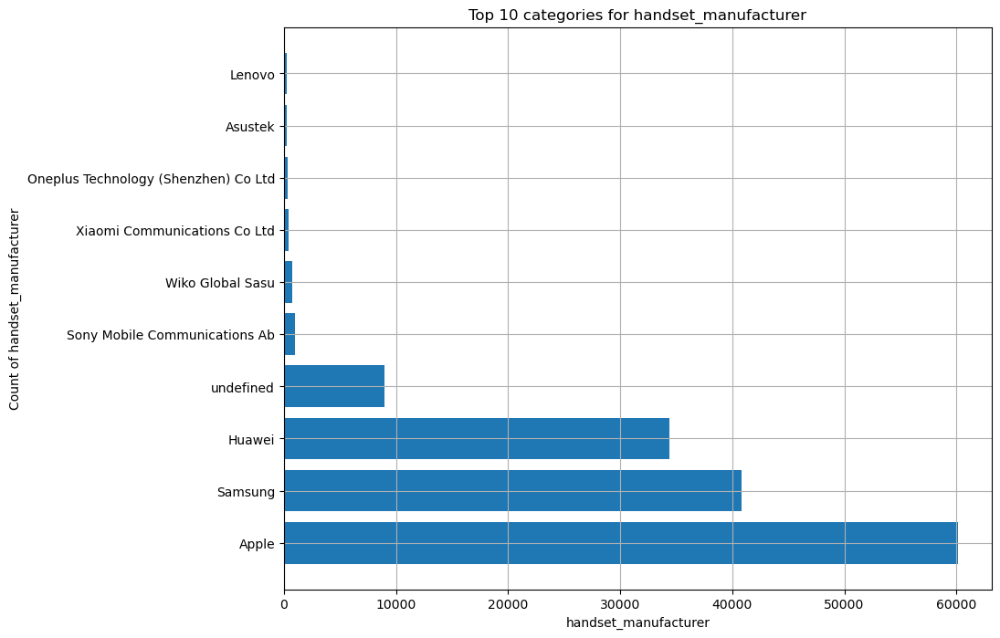

**************************************************
**************************************************
Top 10 categories for handset_type
Huawei B528S-23A                20324
Apple iPhone 6S (A1688)          9419
Apple iPhone 6 (A1586)           9023
undefined                        8987
Apple iPhone 7 (A1778)           6326
Apple iPhone Se (A1723)          5187
Apple iPhone 8 (A1905)           4993
Apple iPhone Xr (A2105)          4568
Samsung Galaxy S8 (Sm-G950F)     4520
Apple iPhone X (A1901)           3813
Name: handset_type, dtype: int64


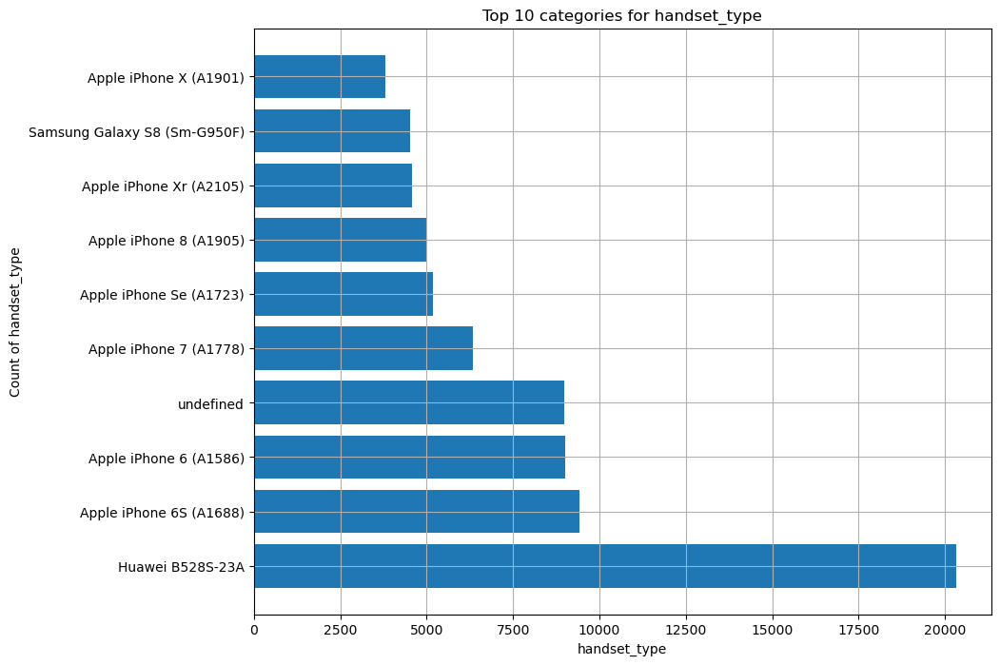

**************************************************


In [31]:
for col in categorical_data:
    print("*"*50)
    print("Top 10 categories for {}".format(col))
    print(df1[col].value_counts().sort_values(ascending = False).head(10))
    index = df1[col].value_counts().sort_values(ascending = False).head(10).index
    values = df1[col].value_counts().sort_values(ascending = False).head(10).values
    plt.figure(figsize = [10,8])
    plt.barh(index,values)
    plt.xlabel(col)
    plt.ylabel("Count of {}".format(col))
    plt.title("Top 10 categories for {}".format(col))
    plt.grid()
    plt.show();
    print("*"*50)

**************************************************
Top 10 categories for start
26-04-2019 07:25    204
26-04-2019 07:26    190
26-04-2019 07:36    175
26-04-2019 07:30    160
26-04-2019 07:46    143
26-04-2019 07:49    138
26-04-2019 07:40    135
26-04-2019 08:25    135
26-04-2019 07:45    133
26-04-2019 07:31    132
Name: start, dtype: int64


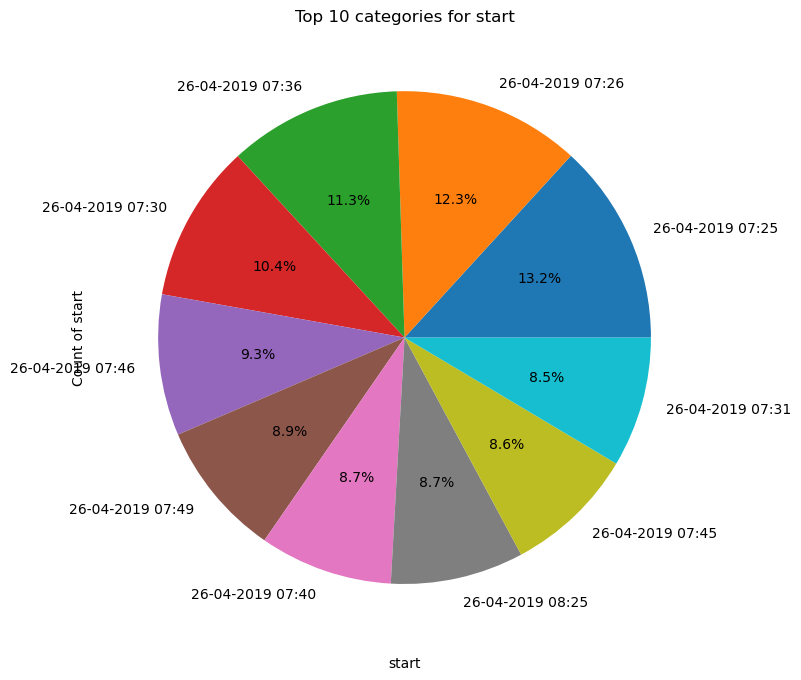

**************************************************
**************************************************
Top 10 categories for end
25-04-2019 00:01    1151
25-04-2019 00:02     418
25-04-2019 00:00     296
25-04-2019 00:48     286
28-04-2019 00:00     275
25-04-2019 00:03     250
28-04-2019 00:06     248
28-04-2019 00:04     246
28-04-2019 00:02     238
28-04-2019 00:05     236
Name: end, dtype: int64


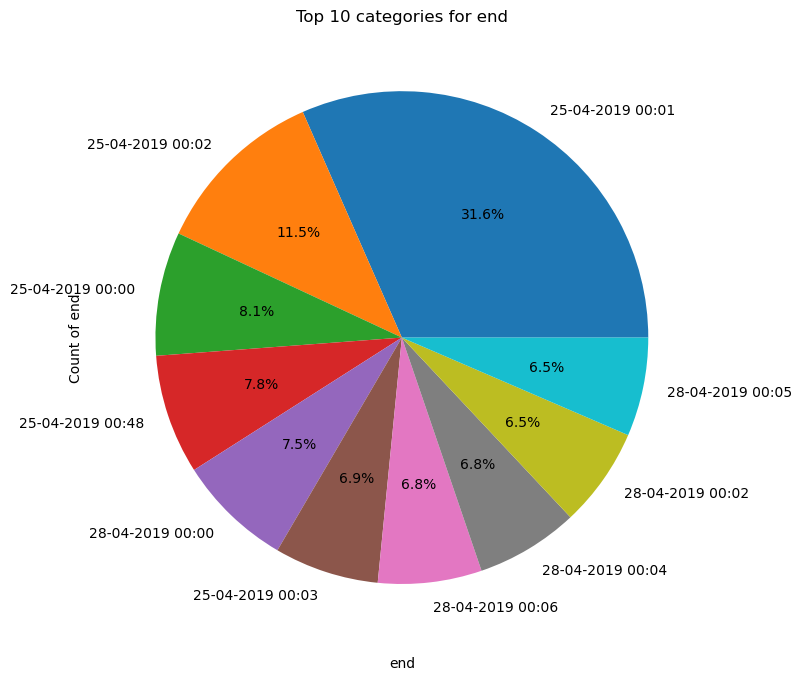

**************************************************
**************************************************
Top 10 categories for last_location_name
9.16457E+15    3034
8.12222E+16     187
D41377B          80
1.5328E+17       61
D17085A          59
D72396C          57
D73604C          55
D11119B          54
L41377B          51
D11002B          50
Name: last_location_name, dtype: int64


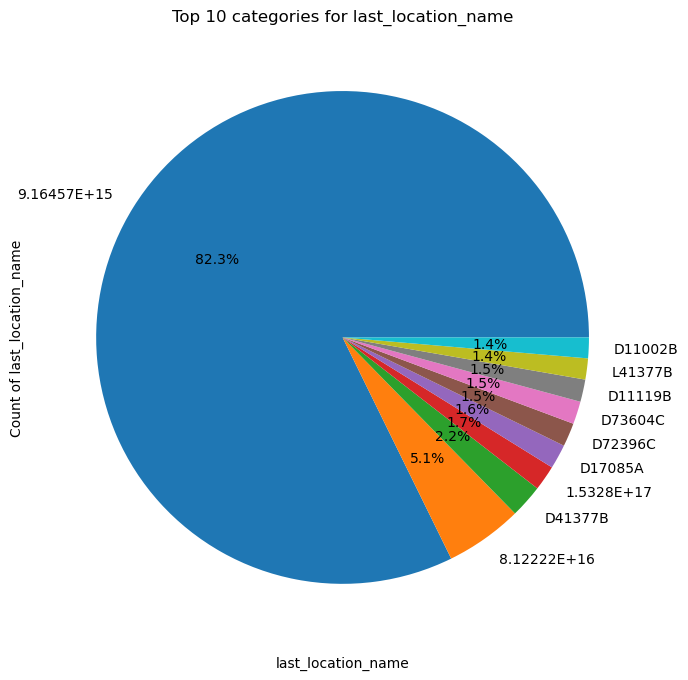

**************************************************
**************************************************
Top 10 categories for handset_manufacturer
Apple                                   60137
Samsung                                 40839
Huawei                                  34423
undefined                                8987
Sony Mobile Communications Ab             980
Wiko Global Sasu                          747
Xiaomi Communications Co Ltd              397
Oneplus Technology (Shenzhen) Co Ltd      342
Asustek                                   285
Lenovo                                    254
Name: handset_manufacturer, dtype: int64


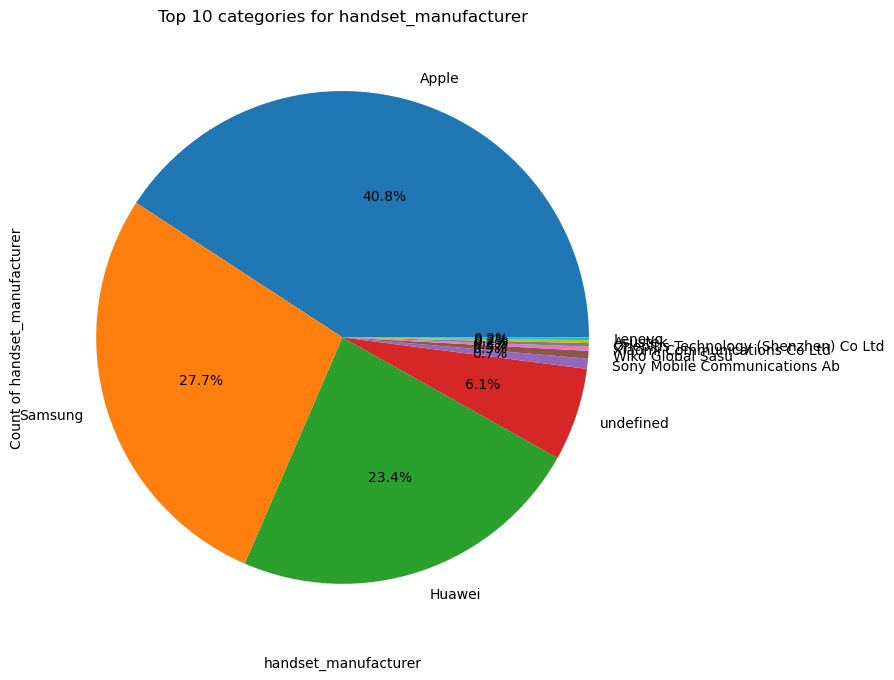

**************************************************
**************************************************
Top 10 categories for handset_type
Huawei B528S-23A                20324
Apple iPhone 6S (A1688)          9419
Apple iPhone 6 (A1586)           9023
undefined                        8987
Apple iPhone 7 (A1778)           6326
Apple iPhone Se (A1723)          5187
Apple iPhone 8 (A1905)           4993
Apple iPhone Xr (A2105)          4568
Samsung Galaxy S8 (Sm-G950F)     4520
Apple iPhone X (A1901)           3813
Name: handset_type, dtype: int64


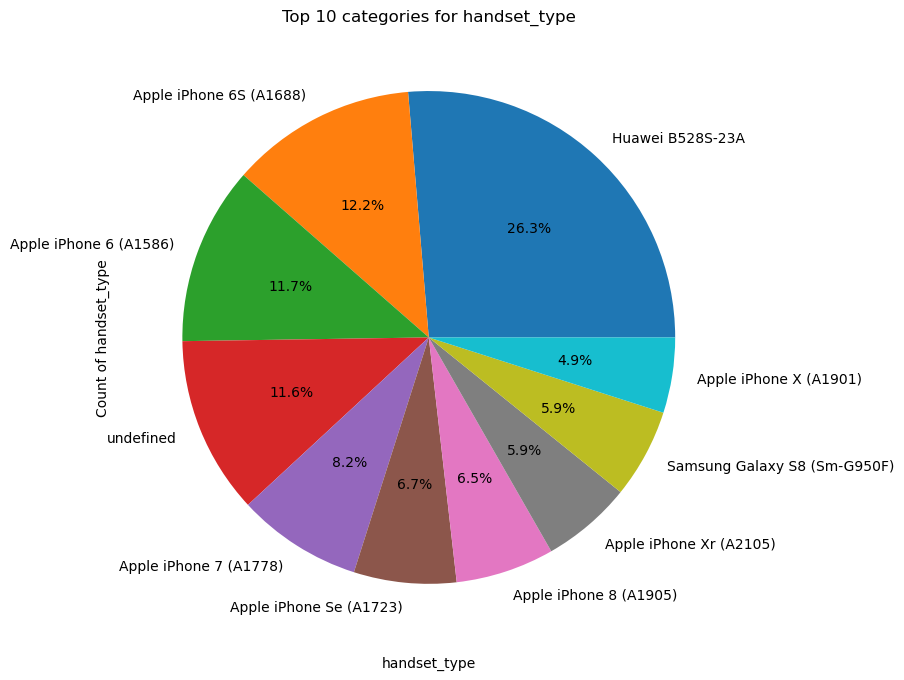

**************************************************


In [32]:
for col in categorical_data:
    print("*"*50)
    print("Top 10 categories for {}".format(col))
    print(df1[col].value_counts().sort_values(ascending = False).head(10))
    index = df1[col].value_counts().sort_values(ascending = False).head(10).index
    values = df1[col].value_counts().sort_values(ascending = False).head(10).values
    plt.figure(figsize = [10,8])
    plt.pie(values, labels = index,autopct = '%.1f%%')
    plt.xlabel(col)
    plt.ylabel("Count of {}".format(col))
    plt.title("Top 10 categories for {}".format(col))
    plt.grid()
    plt.show();
    print("*"*50)

* We choose 13 numerical features to explore from dataset


In [33]:
numerical_df = df1[['msisdn', 'last_location_name',
                                 'handset_manufacturer', 'handset_type', 'duration', 
                                 'social_media', 'google', 'email', 'youtube', 'netflix',
                                 'gaming','other', 'total_data'
                                ]]
numerical_df= numerical_df.rename(columns={'other':'other_data', 'last_location_name':'location'})

In [34]:
numerical_df.head(10)

,msisdn,location,handset_manufacturer,handset_type,duration,social_media,google,email,youtube,netflix,gaming,other_data,total_data
0,3.366496e+10,9.16457E+15,Samsung,Samsung Galaxy A5 Sm-A520F,1823652.0,1570185.0,2905912.0,3701304.0,18355943.0,17855187.0,292426453.0,180558843.0,345629377.0
1,3.368185e+10,L77566A,Samsung,Samsung Galaxy J5 (Sm-J530),1365104.0,1933278.0,4414096.0,937385.0,39359124.0,35565545.0,609920783.0,541959383.0,707185356.0
2,3.376063e+10,D42335A,Samsung,Samsung Galaxy A8 (2018),1361762.0,1726277.0,10229119.0,3363124.0,34425237.0,23751202.0,229980251.0,414908351.0,307690973.0
3,3.375034e+10,T21824A,undefined,undefined,1321509.0,657493.0,11811761.0,2070983.0,36534765.0,15092588.0,810387875.0,761837216.0,889352748.0
4,3.369980e+10,D88865A,Samsung,Samsung Sm-G390F,1089009.0,912788.0,7748843.0,2110349.0,34222253.0,17539799.0,531237049.0,564619822.0,607681403.0
5,3.366819e+10,T89132C,undefined,undefined,1074638.0,3200014.0,12934133.0,2902410.0,23944031.0,13881809.0,723461512.0,659414334.0,784759966.0
6,3.366537e+10,9.16457E+15,Huawei,Huawei Mate 20 Lite,1035261.0,1624991.0,4906872.0,2090979.0,9120760.0,31212766.0,58881157.0,814303325.0,118487293.0
7,3.376349e+10,CELL_208_20_520025_1,undefined,undefined,951292.0,3161403.0,3872713.0,3500104.0,31924969.0,18933702.0,765055811.0,545316477.0,834163359.0
8,3.369874e+10,T42084A,Samsung,Samsung Galaxy A8 (2018),941634.0,372625.0,8902099.0,3380069.0,29297508.0,19054441.0,828219634.0,187669517.0,903975407.0
9,3.365922e+10,L20434C,Samsung,Samsung Galaxy Note 8 (Sm-N950F Ds),864482.0,1585413.0,8778341.0,766046.0,22911539.0,13185350.0,812946425.0,77671250.0,872988322.0


In [35]:
numerical_df1 = numerical_df[['duration', 'social_media', 'google', 'email', 'youtube', 'netflix',
                                 'gaming', 'total_data', 'other_data' ]]

In [36]:
# Describe all relevant variables and associated data types.

numerical_df1.describe().T.style.background_gradient(cmap = "Blues")

,count,mean,std,min,25%,50%,75%,max
duration,150001.000000,104608.560347,81037.351353,7142.000000,57442.000000,86399.000000,132430.000000,1859336.000000
social_media,150001.000000,1828250.208027,1035646.138004,1563.000000,932218.000000,1826471.000000,2727487.000000,3650861.000000
google,150001.000000,7807294.545573,3516420.237959,40330.000000,4943599.000000,7812835.000000,10682796.000000,15528782.000000
email,150001.000000,2259102.309960,1071109.060618,8359.000000,1359344.000000,2263567.000000,3159818.000000,4518036.000000
youtube,150001.000000,22643482.638600,9246800.306557,78903.000000,15998463.000000,22661770.000000,29292604.000000,45190078.000000
netflix,150001.000000,22628606.538380,9260820.086194,98432.000000,15979455.000000,22635545.000000,29290445.000000,45198153.000000
gaming,150001.000000,430333100.706107,244019924.020530,306358.000000,218727939.000000,431614977.000000,641415878.000000,859202784.000000
total_data,150001.000000,495764636.371073,244380987.041604,28956107.000000,284476442.000000,496860994.000000,706505411.000000,955984776.000000
other_data,150001.000000,429365343.618920,243268073.291605,149045.000000,218553417.000000,429986492.000000,639927495.000000,859520934.000000


## Dealing with the Numerical features



###  Outlier detections the application data

[Text(0.5, 1.0, 'Outlier detection for social_media')]

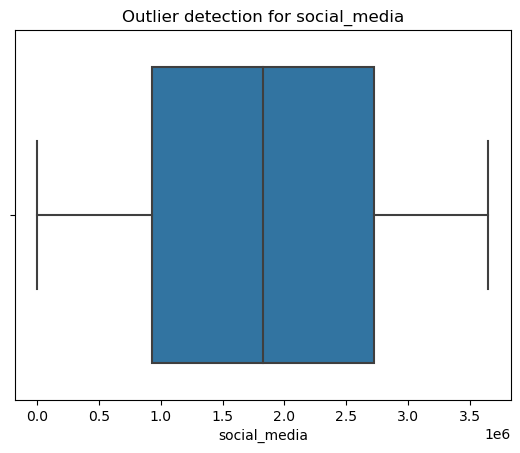

In [37]:
sns.boxplot(data=numerical_df1, x='social_media').set(title="Outlier detection for social_media")

[Text(0.5, 1.0, 'Outlier detection for google')]

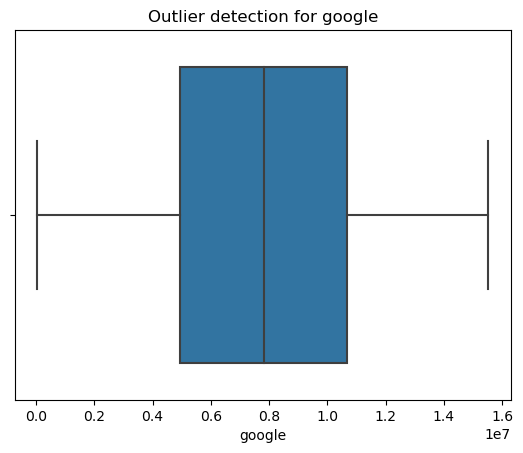

In [38]:
sns.boxplot(data=numerical_df1, x='google').set(title="Outlier detection for google")


[Text(0.5, 1.0, 'Outlier detection for email')]

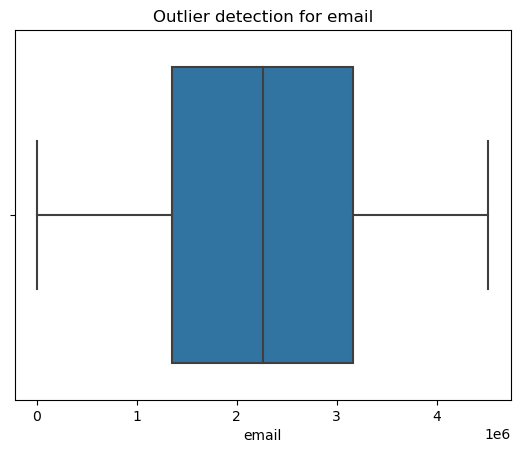

In [39]:
sns.boxplot(data=numerical_df1, x='email').set(title="Outlier detection for email")

[Text(0.5, 1.0, 'Outlier detection for youtube')]

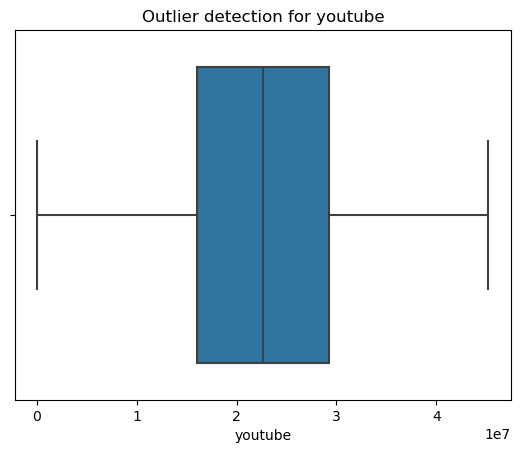

In [40]:
sns.boxplot(data=numerical_df1, x='youtube').set(title="Outlier detection for youtube")

[Text(0.5, 1.0, 'Outlier detection for netflix')]

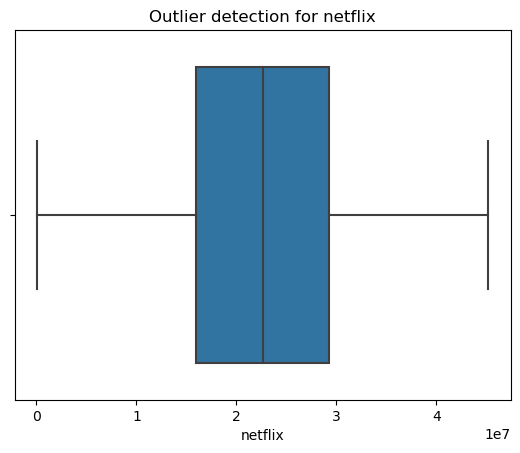

In [41]:
sns.boxplot(data=numerical_df1, x='netflix').set(title="Outlier detection for netflix")

[Text(0.5, 1.0, 'Outlier detection for total_data')]

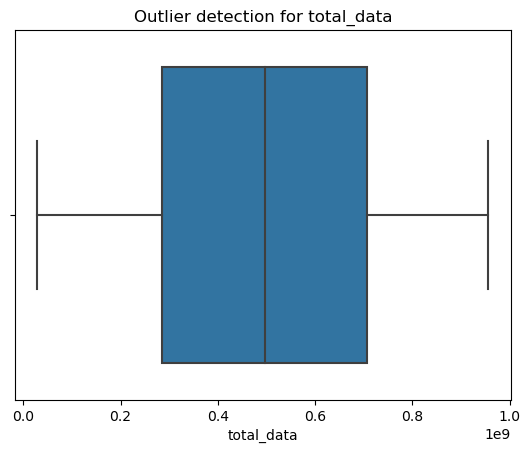

In [42]:
sns.boxplot(data=numerical_df1, x='total_data').set(title="Outlier detection for total_data")

[Text(0.5, 1.0, 'Outlier detection for other_data')]

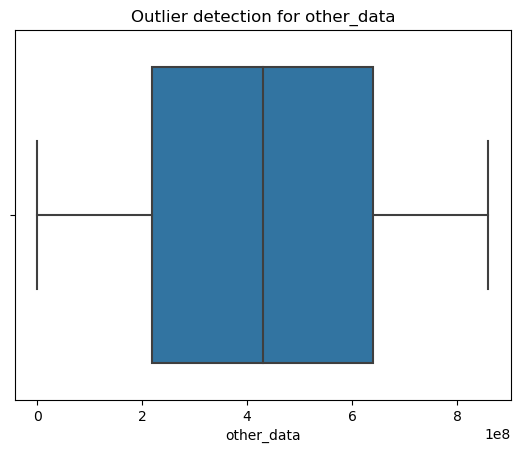

In [43]:
sns.boxplot(data=numerical_df1, x='other_data').set(title="Outlier detection for other_data")

There is no outliers present in above features.

[Text(0.5, 1.0, 'Outlier detection for duration(ms)')]

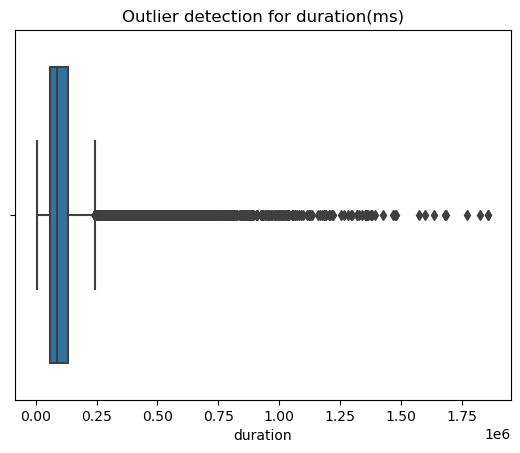

In [44]:
sns.boxplot(data=numerical_df1, x='duration').set(title="Outlier detection for duration(ms)")

There is outliers present in above features. Let's deal with these outliers 

In [45]:
numerical_df1['duration'] = np.where(numerical_df1['duration'] > numerical_df1['duration'].quantile(0.95),
                                         numerical_df1['duration'].mode(),numerical_df1['duration'])

[Text(0.5, 1.0, 'Outlier detection for duration(ms)')]

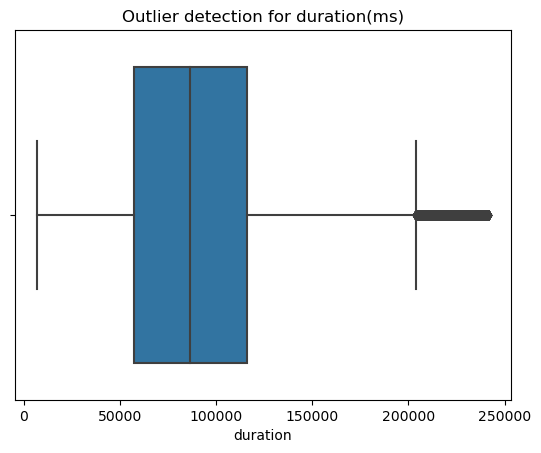

In [46]:
sns.boxplot(data=numerical_df1, x='duration').set(title="Outlier detection for duration(ms)")

In [47]:
def hist_plot(numerical_df1:pd.DataFrame, column:str, color:str):
    plt.figure(figsize=(9, 7))
    sns.displot(data=numerical_df1, x=column,color=color, kde=True, height=7, aspect=2)
    plt.title(f'Distribution of {column}', size=20, fontweight='bold')
    plt.show()

<Figure size 900x700 with 0 Axes>

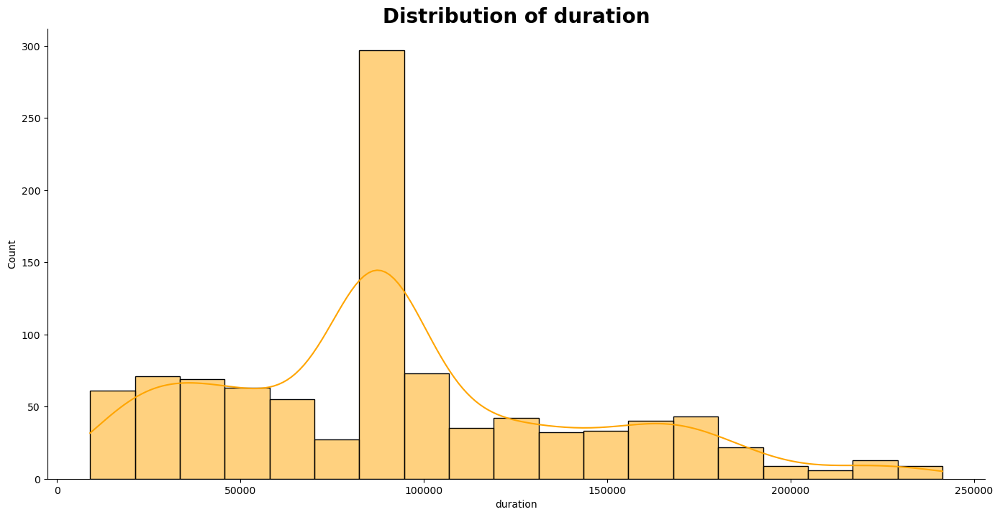

In [48]:
hist_plot(numerical_df1.sample(1000), 'duration',color="orange")

<Figure size 900x700 with 0 Axes>

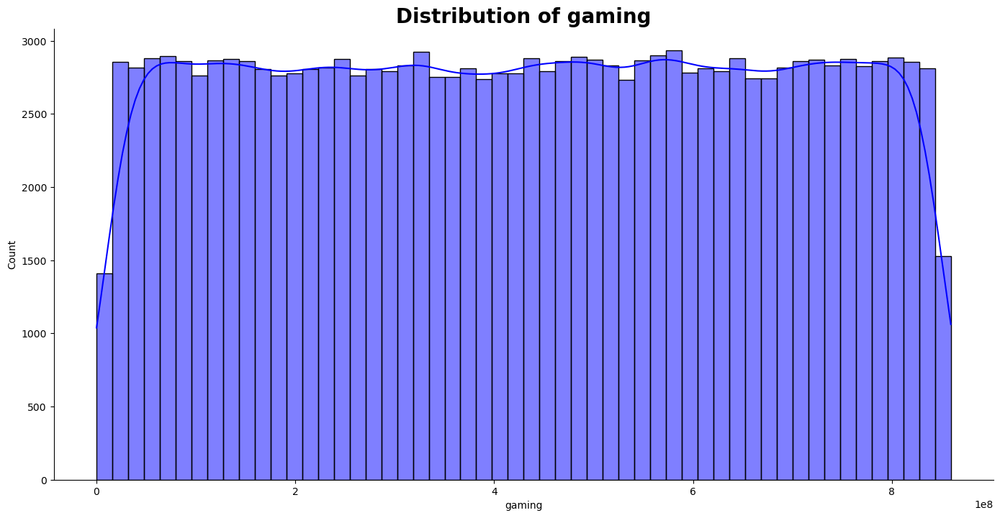

In [49]:
hist_plot(numerical_df1, 'gaming',color="blue")

<Figure size 900x700 with 0 Axes>

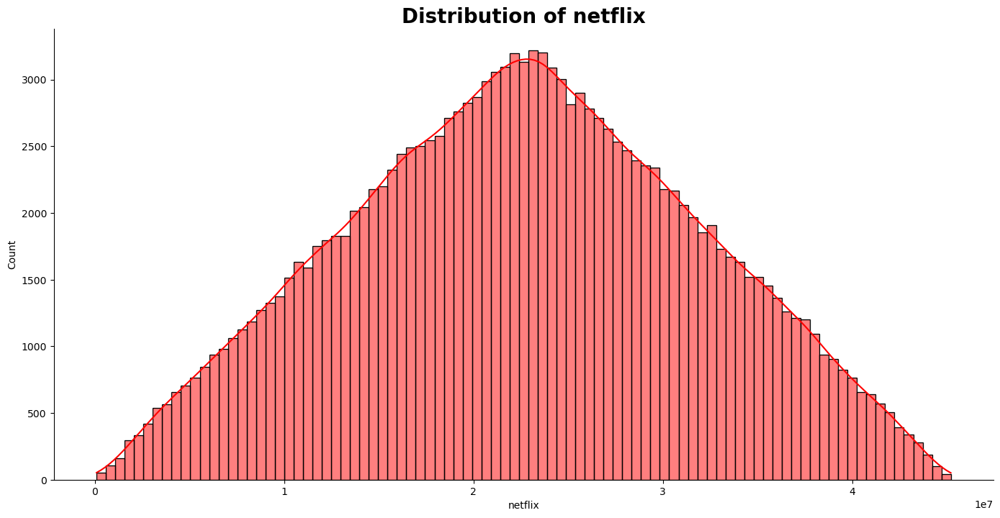

In [50]:
hist_plot(numerical_df1, 'netflix',color="red")

<Figure size 900x700 with 0 Axes>

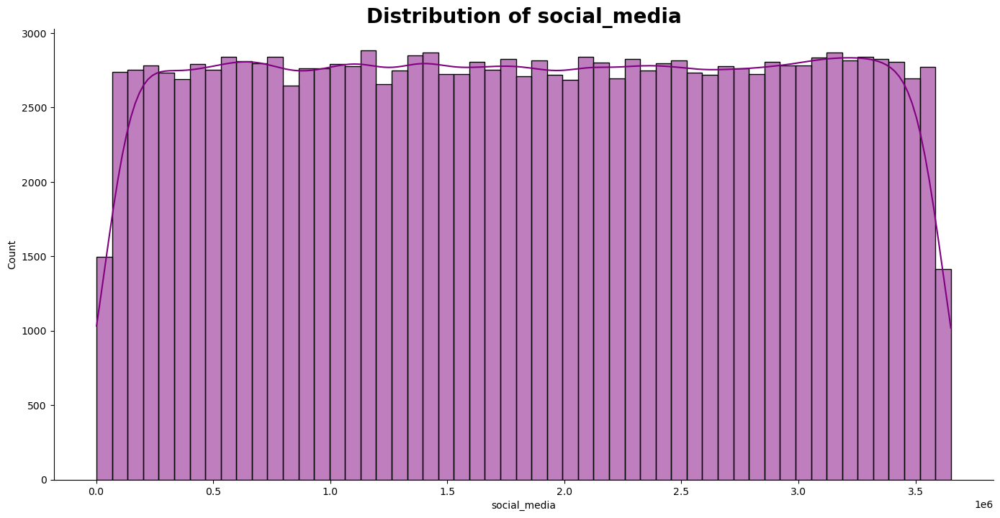

In [51]:
hist_plot(numerical_df1, 'social_media',color="purple")

<Figure size 900x700 with 0 Axes>

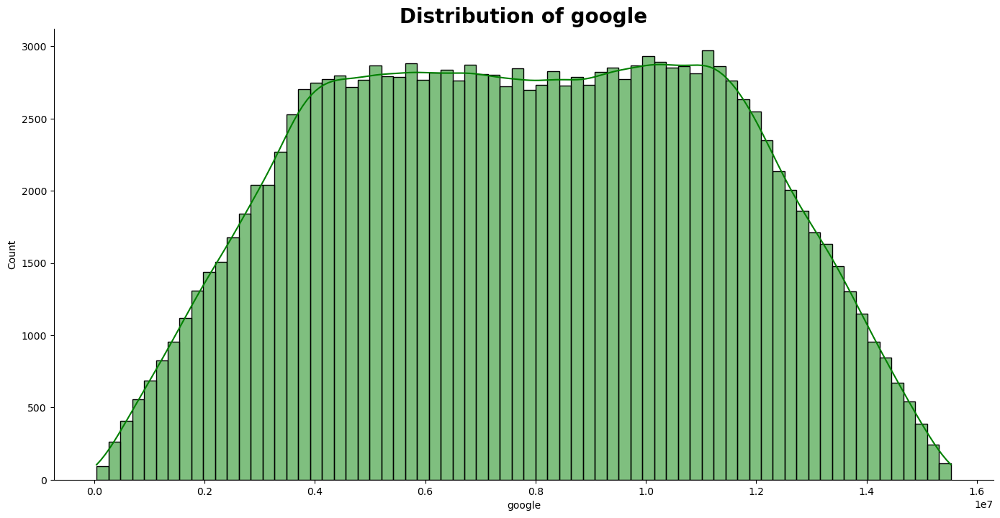

In [52]:
hist_plot(numerical_df1, 'google',color="green")

<Figure size 900x700 with 0 Axes>

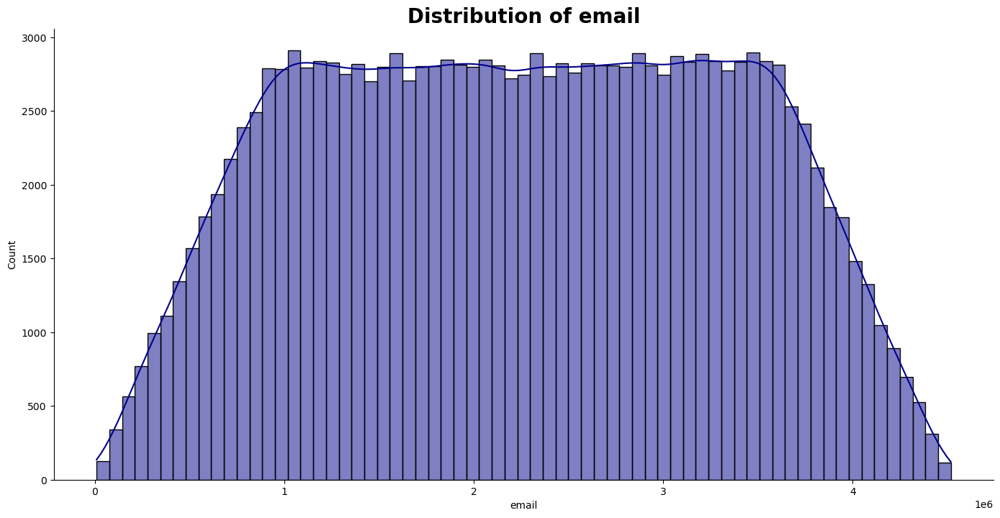

In [60]:
hist_plot(numerical_df1, 'email',color="darkblue")

<Figure size 900x700 with 0 Axes>

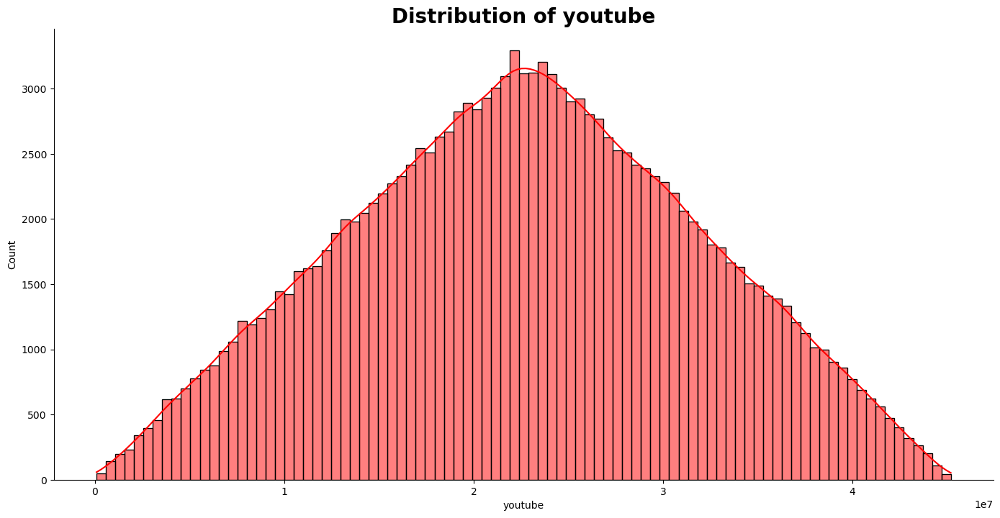

In [63]:
hist_plot(numerical_df1, 'youtube',color="red")

## Multivariate Analysis

In [64]:
top_5_manufacturers = numerical_df["handset_manufacturer"].value_counts().head(5)
print("\nTop 5 Handsets Manufacturers :")
print(top_5_manufacturers)


Top 5 Handsets Manufacturers :
Apple                            60137
Samsung                          40839
Huawei                           34423
undefined                         8987
Sony Mobile Communications Ab      980
Name: handset_manufacturer, dtype: int64


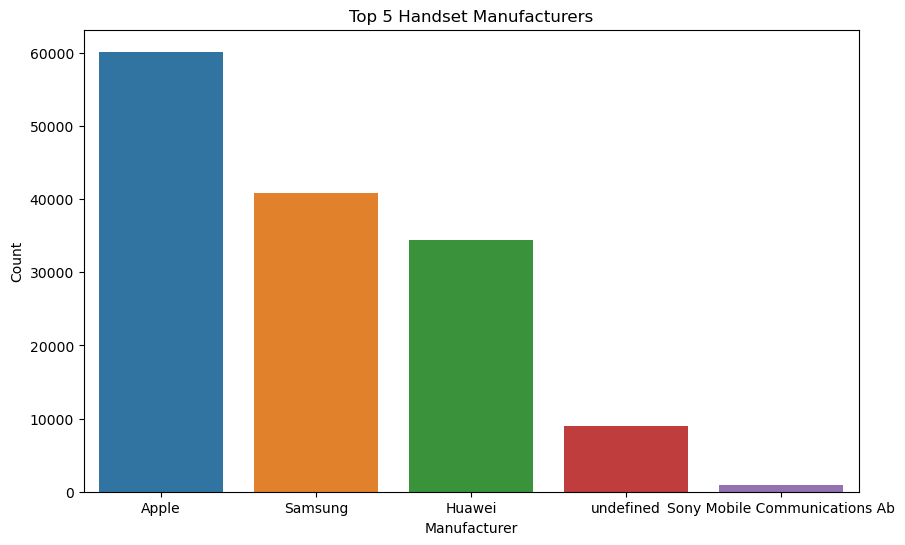

In [65]:
plt.figure(figsize=(10, 6))
sns.barplot(x=top_5_manufacturers.index, y=top_5_manufacturers.values)
plt.title("Top 5 Handset Manufacturers")
plt.xlabel("Manufacturer")
plt.ylabel("Count")
plt.show()

### Total Data used by each application per user

In [66]:
def scatter_plot(df: pd.DataFrame, x_col: str, y_col: str, title: str, hue: str, style: str) -> None:
    plt.figure(figsize=(10, 8))
    sns.scatterplot(data = df1, x=x_col, y=y_col, hue=hue, style=style)
    plt.title(title, size=20)
    plt.xticks(fontsize=14)
    plt.yticks( fontsize=14)
    plt.show()
    

In [67]:
total_data_app = df1[['msisdn','social_media','google','email', 'youtube','netflix', 'gaming','other','total_data','handset_manufacturer']].copy()
total_data_agg = total_data_app.groupby('msisdn').sum()
total_data_agg

,social_media,google,email,youtube,netflix,gaming,other,total_data
msisdn,,,,,,,,
3.360100e+10,2.232135e+06,4.389005e+06,1.331362e+06,2.162455e+07,2.718098e+07,8.124587e+08,3.865709e+08,8.786906e+08
3.360100e+10,2.660565e+06,5.334863e+06,3.307781e+06,1.243222e+07,1.122176e+07,1.197501e+08,2.817101e+08,1.568596e+08
3.360100e+10,3.195623e+06,3.443126e+06,3.205380e+06,2.133357e+07,1.935390e+07,5.388277e+08,5.016937e+08,5.959665e+08
3.360101e+10,2.802940e+05,9.678493e+06,2.284670e+06,6.977321e+06,1.942092e+06,3.911261e+08,3.527970e+07,4.223207e+08
3.360101e+10,2.912542e+06,1.849962e+07,3.305469e+06,4.153300e+07,4.920172e+07,1.314798e+09,8.048045e+08,1.457411e+09
...,...,...,...,...,...,...,...,...
3.379000e+10,4.985690e+05,5.429705e+06,2.514097e+06,1.985157e+07,8.531060e+06,4.370033e+08,2.111151e+08,4.803073e+08
4.188282e+10,1.973817e+09,8.248577e+09,2.399880e+09,2.434073e+10,2.425357e+10,4.614780e+11,4.509784e+11,5.317447e+11
3.197020e+12,7.152240e+05,1.043866e+07,1.520771e+06,1.195990e+07,2.659230e+07,1.780487e+08,4.705265e+08,2.321240e+08


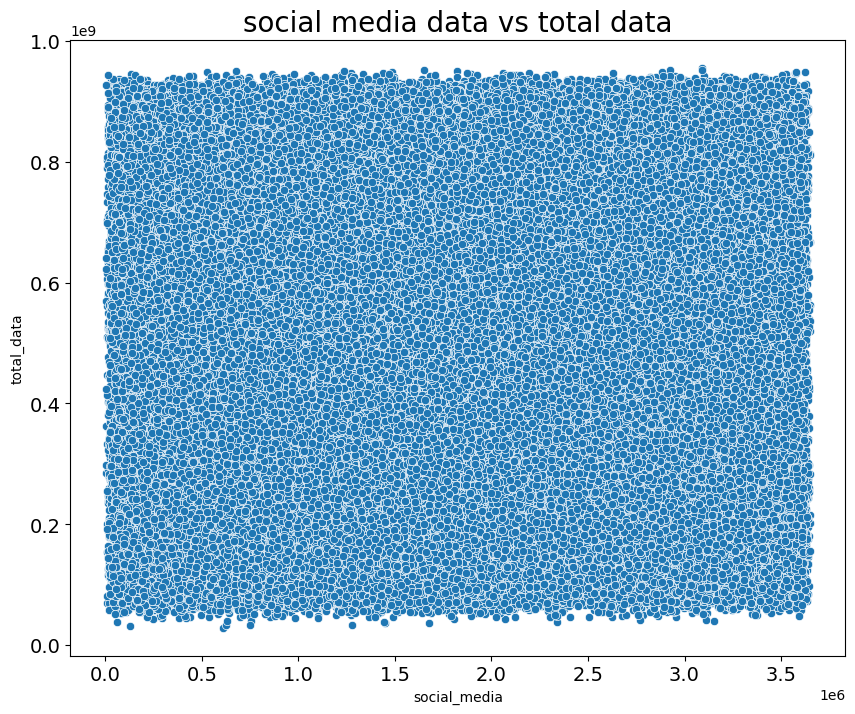

In [68]:
scatter_plot(total_data_agg, 'social_media', 'total_data', 'social media data vs total data',  None,  None)

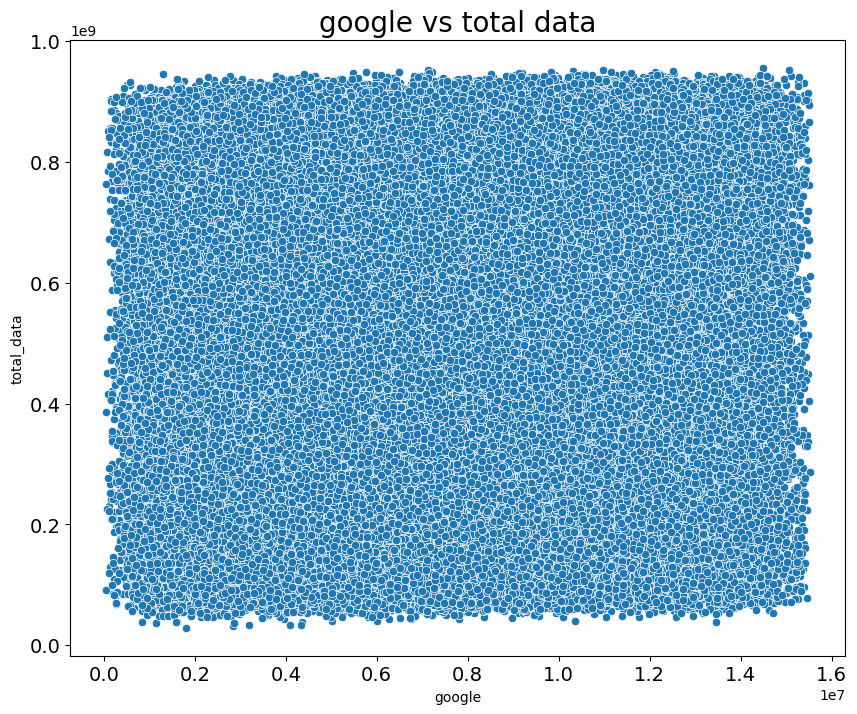

In [69]:
scatter_plot(total_data_agg, 'google', 'total_data', 'google vs total data',  None,  None)

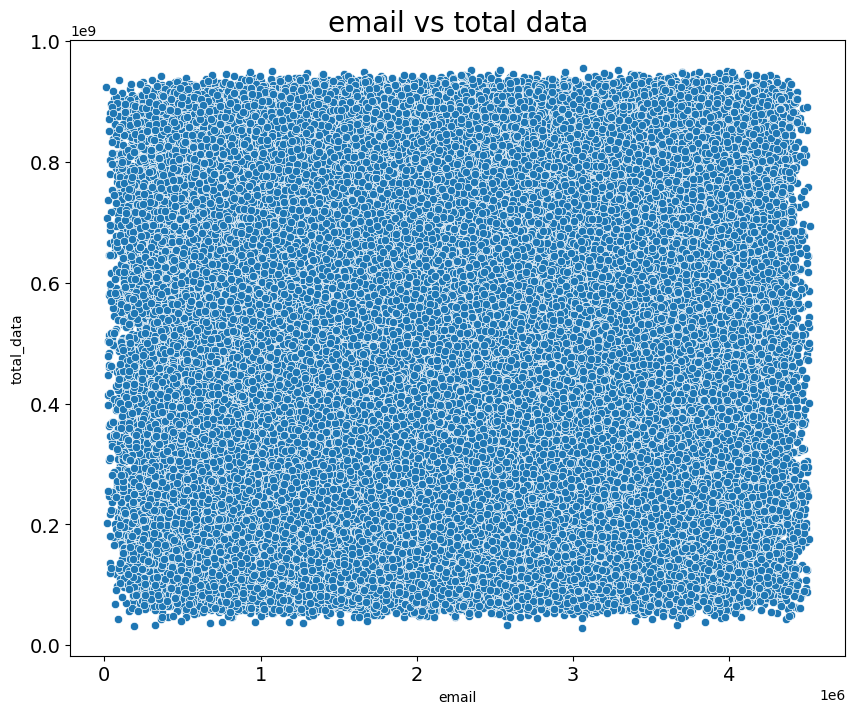

In [70]:
scatter_plot(total_data_agg, 'email', 'total_data', 'email vs total data',  None,  None)

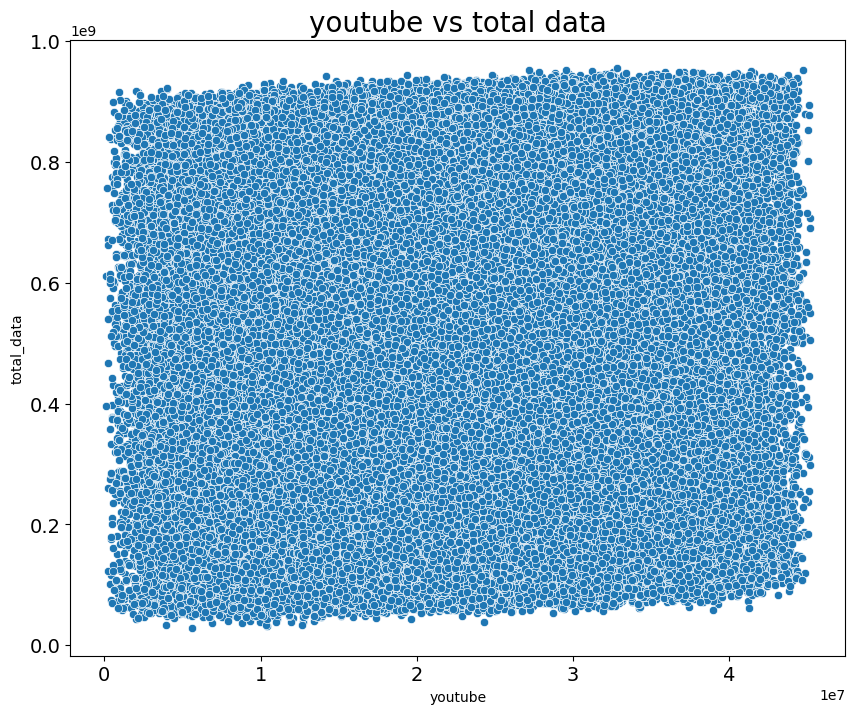

In [71]:
scatter_plot(total_data_agg, 'youtube', 'total_data', 'youtube vs total data',  None,  None)

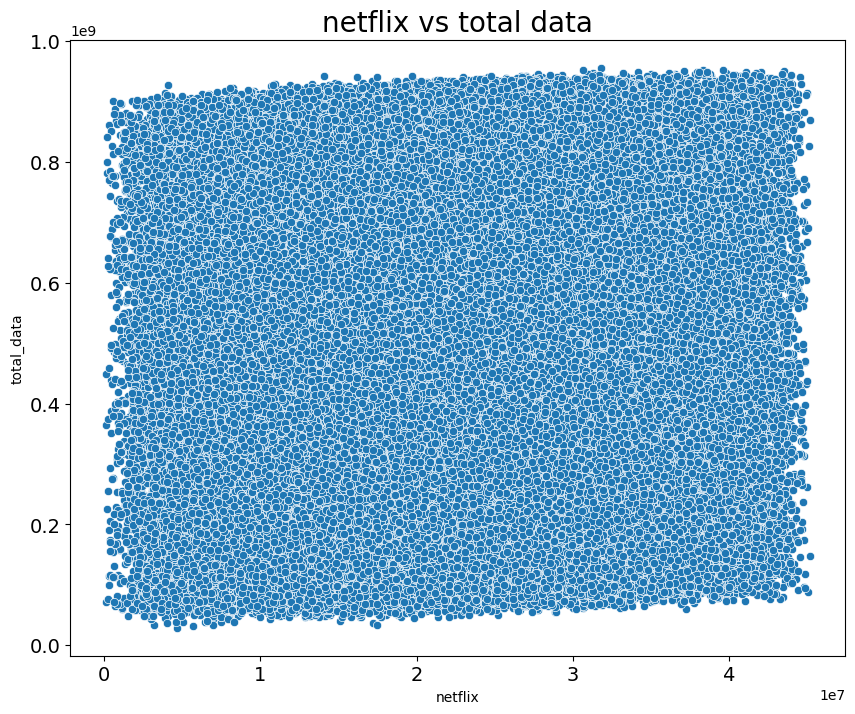

In [72]:
scatter_plot(total_data_agg, 'netflix', 'total_data', 'netflix vs total data',  None,  None)

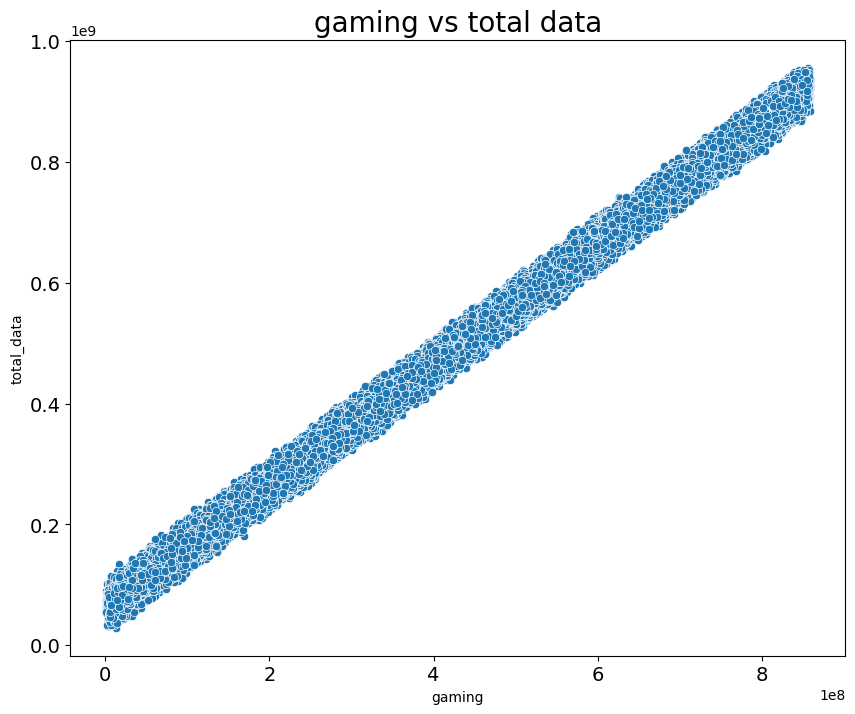

In [73]:
scatter_plot(total_data_agg, 'gaming', 'total_data', 'gaming vs total data',  None,  None)

In [74]:
total_data = df1[['social_media','google','email', 'youtube','netflix', 'gaming','other','total_data']]

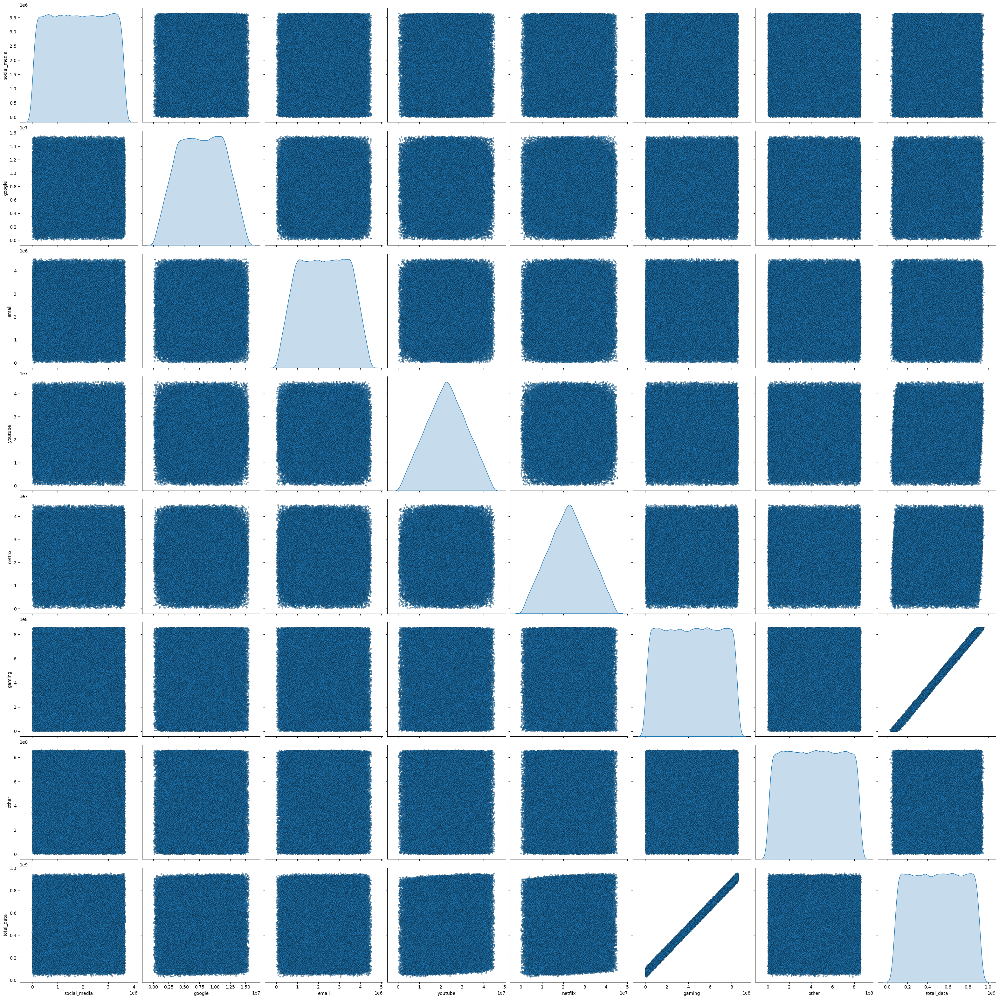

In [75]:
sns.color_palette("rocket", as_cmap=True)
sns.pairplot(total_data, diag_kind = 'kde',
             plot_kws = {'alpha': 0.6, 's': 10, 'edgecolor': 'k'},
             height=4)

### Multivariate Analysis of categorical features

In [76]:
index = ['social_media','google','email','youtube','netflix','gaming','other']

values = [
    df1['social_media'].sum(),
    df1['google'].sum(),
    df1['email'].sum(),
    df1['youtube'].sum(),
    df1['netflix'].sum(),
    df1['gaming'].sum(),
   df1['other'].sum(),
   ]
colors = ['green','darkblue','purple','red','blue']

In [77]:
data = {'App': index, 'Total Data': values}

# Create a DataFrame from the dictionary
app_total_data_count_df = pd.DataFrame(data)

# Display the table
print(app_total_data_count_df)

            App    Total Data
0  social_media  2.742394e+11
1        google  1.171102e+12
2         email  3.388676e+11
3       youtube  3.396545e+12
4       netflix  3.394314e+12
5        gaming  6.455040e+13
6         other  6.440523e+13


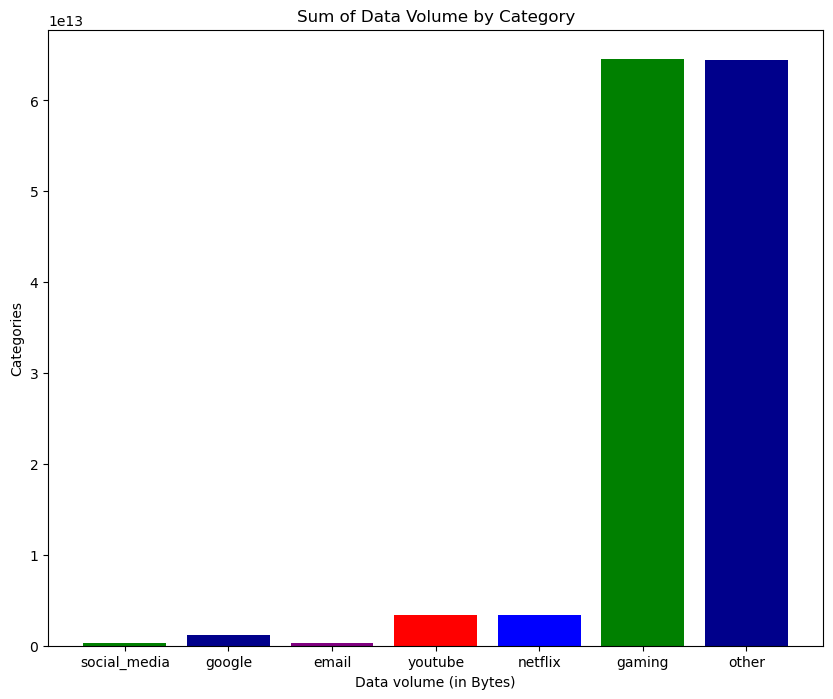

In [78]:
plt.figure(figsize = [10,8])
plt.bar(index, values, color=colors)
plt.xlabel("Data volume (in Bytes)")
plt.ylabel("Categories")
plt.title("Sum of Data Volume by Category")
plt.show();

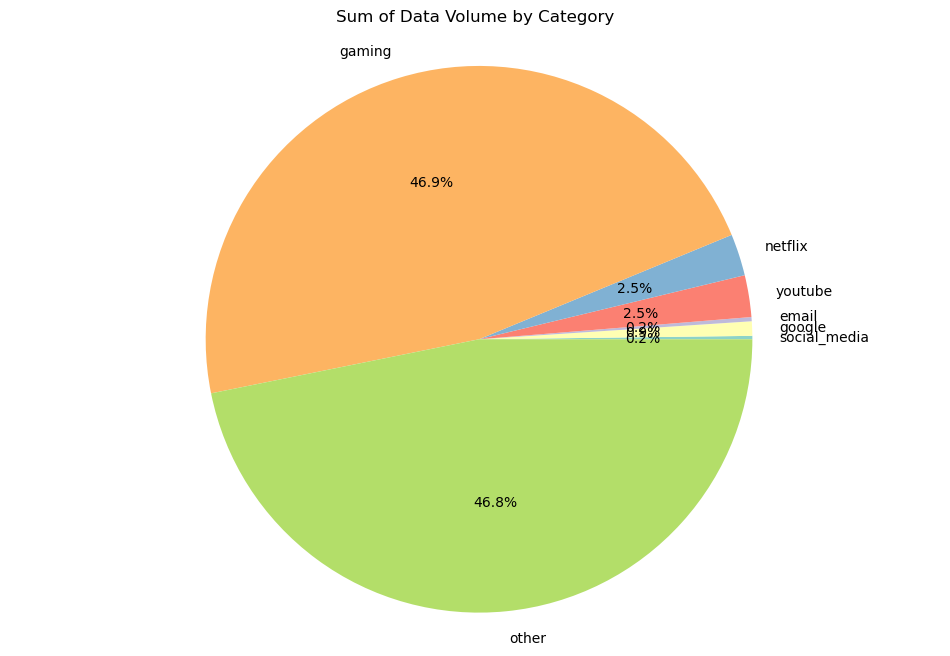

In [79]:
plt.figure(figsize=[12, 8])
plt.pie(values, labels=index, autopct='%1.1f%%',colors=plt.cm.Set3.colors)
plt.axis('equal')
plt.title("Sum of Data Volume by Category")
plt.show()

## Variable transformations 

• Variable transformations – segment the users into the top five decile classes based on the total duration for all sessions and compute the total data (DL+UL) per decile class.

In [134]:
# Calculate the total duration for each user by summing the duration across all sessions. Let's call this column "total_duration"

scaled_df1 = df1[['msisdn', 'total_data', 'duration']]

scaled_df1_agg = scaled_df1.groupby('msisdn').agg({'duration':'sum', 'total_data': 'sum'})

# Calculate the deciles for the total duration
deciles = pd.qcut(scaled_df1_agg['duration'], 5 ,labels=False)

In [135]:
df1_with_decile = scaled_df1_agg.copy()

df1_with_decile['decile'] = deciles

df1_with_decile_agg = df1_with_decile.groupby('decile').agg({'total_data': 'sum','duration': 'sum'})
df1_with_decile_agg

,total_data,duration
decile,,
0,1.154869e+13,6.443451e+08
1,1.257064e+13,1.807896e+09
2,1.156998e+13,2.124983e+09
3,1.397471e+13,3.448610e+09
4,2.470117e+13,7.665555e+09


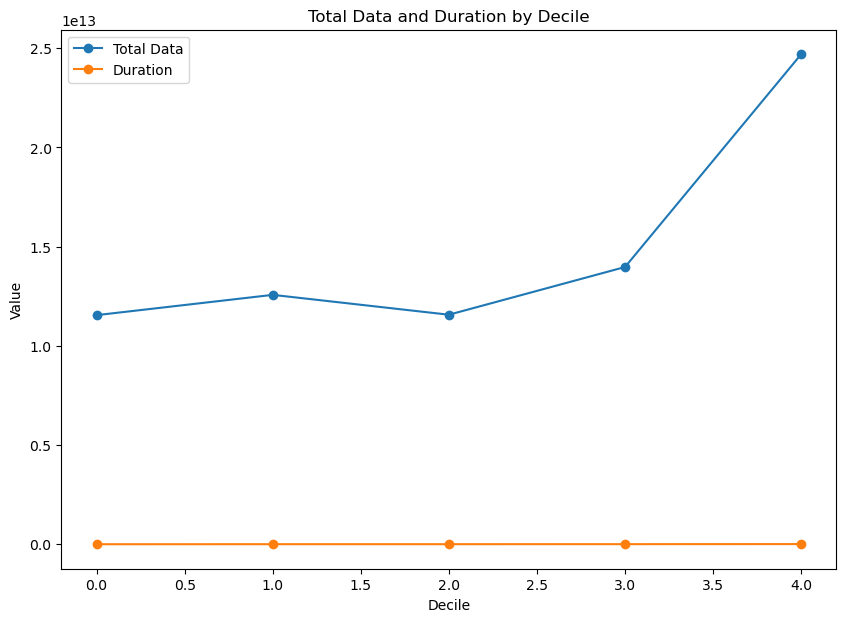

In [136]:
# Create a line plot
plt.figure(figsize=(10,7))
plt.plot(df1_with_decile_agg.index, df1_with_decile_agg['total_data'], marker='o', label='Total Data')
plt.plot(df1_with_decile_agg.index, df1_with_decile_agg['duration'], marker='o', label='Duration')

# Set plot labels and title
plt.xlabel('Decile')
plt.ylabel('Value')
plt.title('Total Data and Duration by Decile')

# Add a legend
plt.legend()

# Display the plot
plt.show()


## Correlation Analysis

In [141]:
corr_matrix = df1[['social_media','google','email', 'youtube','netflix', 'gaming','other','total_data']].corr()
corr_matrix

,social_media,google,email,youtube,netflix,gaming,other,total_data
social_media,1.000000,-0.001708,0.004032,0.000548,0.001013,0.001082,0.006065,0.005383
google,-0.001708,1.000000,-0.000412,0.002277,-0.001902,-0.000994,-0.001727,0.013370
email,0.004032,-0.000412,1.000000,-0.002919,0.001029,-0.000644,-0.001299,0.003768
youtube,0.000548,0.002277,-0.002919,1.000000,0.002882,-0.002999,0.002969,0.034888
netflix,0.001013,-0.001902,0.001029,0.002882,1.000000,-0.003109,-0.009033,0.034798
gaming,0.001082,-0.000994,-0.000644,-0.002999,-0.003109,1.000000,-0.002661,0.998254
other,0.006065,-0.001727,-0.001299,0.002969,-0.009033,-0.002661,1.000000,-0.002443
total_data,0.005383,0.013370,0.003768,0.034888,0.034798,0.998254,-0.002443,1.000000


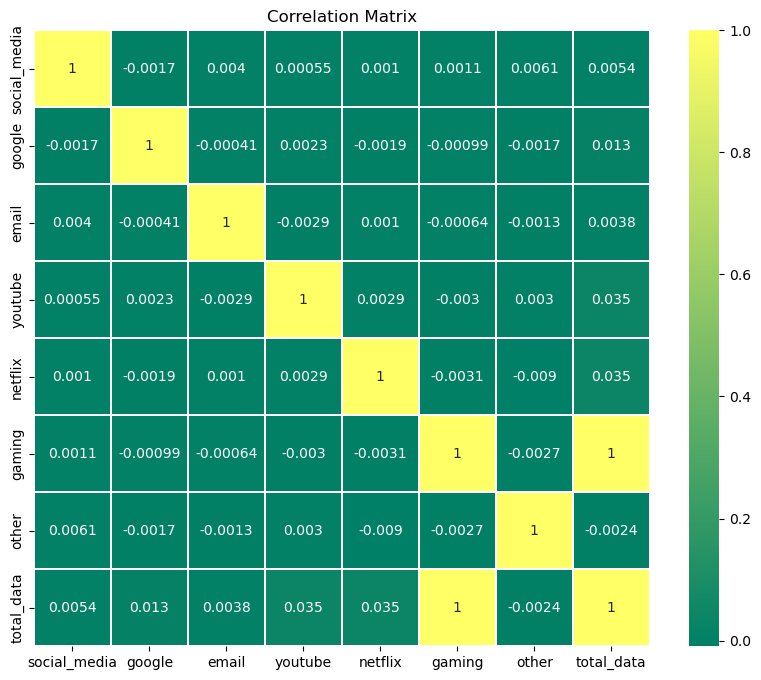

In [155]:
plt.figure(figsize = (10,8))
sns.heatmap(corr_matrix,vmax=1, linewidths=0.01,square=True,annot=True,cmap='summer')
plt.title('Correlation Matrix')
plt.show()

* We can see that each applcation data volume has no significant coorelation

* This can suggest that each application data is as important as the other

## Dimesionality Reduction- perform a principal component analysis to reduce the dimensions of your data and provide a useful interpretation of the results

In [1]:
# Dimensionality Reduction
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

In [31]:
principal_components = pca.fit_transform(df1[['social_media','google','email', 'youtube','netflix', 'gaming','other','total_data']])

In [33]:
principal_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])
principal_df.head()

,PC1,PC2
0,2.027963e+08,-2.495330e+08
1,-2.761095e+08,1.135827e+08
2,2.745934e+08,-1.543631e+07
3,-5.458661e+08,3.344306e+08
4,-1.500110e+08,1.357958e+08


* PC1 : The values in PC1 column represent the overall data usage or activity level of each data point (row) in the original dataset. Positive values indicate higher data usage/activity, while negative values indicate lower data usage/activity. For example, in the first row, the PC1 value is 2.027963e+08, suggesting a relatively high data usage/activity level for that particular data point.


* PC2 : The values in PC2 column capture a specific pattern or variation in the original dataset that is orthogonal (uncorrelated) to PC1. Similar to PC1, positive values in PC2 indicate one type of pattern or variation, while negative values indicate another type. In the second row, the PC2 value is 1.135827e+08, indicating a specific pattern or variation associated with that data point.


* Each row in the table corresponds to a data point from the original dataset. In this case, the original dataset includes features related to social media, Google, email, YouTube, Netflix, gaming, other activities, and total data usage.


* The PCA algorithm has reduced the dimensionality of the original dataset (which had eight features) to two principal components (PC1 and PC2). These two components capture the most significant patterns or variations in the data, allowing for visualization or further analysis in a lower-dimensional space.

In [36]:
# Variance explained by each principal component
explained_variance = pca.explained_variance_ratio_*100
print("Variance Explained by PC1:", explained_variance[0])
print("Variance Explained by PC2:", explained_variance[1])

Variance Explained by PC1: 66.7091205435332
Variance Explained by PC2: 33.12859294142424


* Variance Explained by PC1: 66.7091205435332 This value represents the proportion of variance in the original dataset that is explained by the first principal component, PC1. In this case, PC1 explains approximately 67% of the total variance in the data. This suggests that PC1 captures a significant amount of information and is a strong contributor to the overall variability in the dataset.


* Variance Explained by PC2: 33.12859294142424 Similarly, this value represents the proportion of variance in the original dataset that is explained by the second principal component, PC2. In this case, PC2 explains approximately 33% of the total variance in the data. While PC2 explains less variance compared to PC1, it still contributes significantly to the overall variability in the dataset.


* Together, PC1 and PC2 explain a cumulative variance of approximately 99.83% (66.7091205435332 + 33.12859294142424) in the original dataset. This indicates that these two principal components capture the majority of the information present in the data.